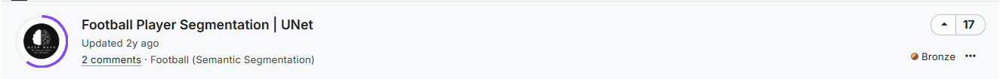

In [1]:
# Common
import os 
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow import keras

# Data 
from glob import glob
from tqdm import tqdm
import tensorflow.image as tfi
from tensorflow.keras.preprocessing.image import load_img, img_to_array

# Data Visualization
import matplotlib.pyplot as plt

# Model
from tensorflow.keras.layers import add
from tensorflow.keras.layers import Input
from tensorflow.keras.layers import Layer
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import multiply
from tensorflow.keras.layers import Dropout
from tensorflow.keras.layers import MaxPool2D
from tensorflow.keras.layers import Concatenate
from tensorflow.keras.layers import Conv2DTranspose
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.callbacks import Callback, ModelCheckpoint
from tensorflow.keras.models import Model

# Model Visualization
from tensorflow.keras.utils import plot_model

In [2]:
#wandb
import wandb
from datetime import datetime
current_time = datetime.now().strftime("%Y-%m-%d-%H:%M:%S")
run_name = "run_" + current_time
wandb.login(key="a96035366c44c4ac930354c4d3bda0f9499c339e")
hyperparameter_defaults = dict(
    epochs = 100,
    batch_size = 4
)
config = {
    "project":"FootBall Player Segmentation",
    "name": run_name,
    "config":hyperparameter_defaults
}
wandb.init(**config)

wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: huchencao08 (huchencao08-shanghai-university). Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: C:\Users\Leaper\_netrc


In [3]:
# Root Path
image_paths = r'D:\code_study\ML_CODE\dataSets\Segmentation\Football_Semantic_Segmentation\archive\images'
image_paths = image_paths.replace("\\","/") + "/"
# All Images and thier respective maps
all_images = glob(image_paths + "*.jpg")
all_paths = [path.replace(".jpg",".jpg___fuse.png") for path in all_images]

In [4]:
all_images[0]

'D:/code_study/ML_CODE/dataSets/Segmentation/Football_Semantic_Segmentation/archive/images\\Frame 1  (1).jpg'

In [5]:
all_paths[0]

'D:/code_study/ML_CODE/dataSets/Segmentation/Football_Semantic_Segmentation/archive/images\\Frame 1  (1).jpg___fuse.png'

In [6]:
def load_image(path, SIZE=256):
    image = load_img(path)
    # 将PIL图像转换为NumPy数组
    image = img_to_array(image)
    image = tfi.resize(image, (SIZE, SIZE))
    image = img_to_array(image)
    image = tf.cast(image, tf.float32)
    image = image/255.
    return image

def load_data(image_paths, label_paths, SIZE=256):
    images, label_maps = np.zeros(shape=(len(image_paths), SIZE, SIZE, 3)), np.zeros(shape=(len(label_paths), SIZE, SIZE, 3))
    for i, (image_path, label_path) in tqdm(enumerate(zip(image_paths, label_paths)), desc="Loading"):
        image, label_map = load_image(image_path, SIZE=SIZE), load_image(label_path, SIZE=SIZE)
        images[i], label_maps[i] = image, label_map
    return images, label_maps

In [7]:
images, label_maps = load_data(all_images, all_paths)

Loading: 100it [00:04, 20.96it/s]


In [8]:
def show_map(image, label_map, alpha_1=1, alpha_2=0.7):
    plt.imshow(image, alpha=alpha_1)
    plt.imshow(label_map, alpha=alpha_2)
    plt.axis('off')

In [9]:
def show_maps(images, label_maps, GRID=[5,6], SIZE=(25,25)):
    
    # Plot Configuration
    n_rows, n_cols = GRID
    n_images = n_rows * n_cols
    plt.figure(figsize=SIZE)
    
    # Iterate through the Data
    i=1
    for image, label_map in zip(images, label_maps):
        
        # Plot Image
        plt.subplot(n_rows, n_cols, i)
        show_map(image, label_map)
        
        i+=1
        if i>n_images:
            break
    
    # Final Plot
    plt.show()

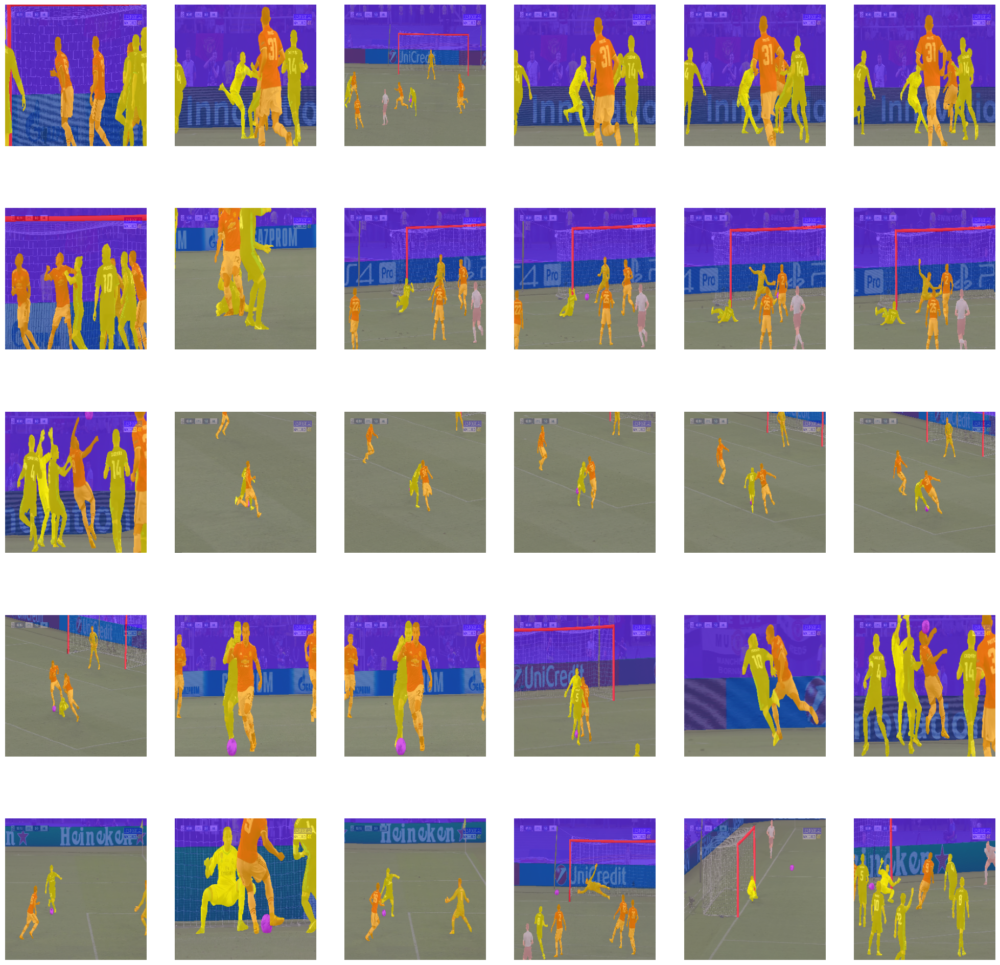

In [10]:
show_maps(images, label_maps)

In [11]:
class Encoder(Layer):
    
    def __init__(self, filters, rate=0.2, pooling=True, **kwargs):
        super(Encoder, self).__init__(**kwargs)
        
        self.filters = filters
        self.rate = rate
        self.pooling = pooling
        
        self.bn = BatchNormalization()
        self.c1 = Conv2D(filters, kernel_size=3, strides=1, padding='same', activation='relu', kernel_initializer='he_normal')
        self.drop = Dropout(rate)
        self.c2 = Conv2D(filters, kernel_size=3, strides=1, padding='same', activation='relu', kernel_initializer='he_normal')
        self.pool = MaxPool2D()
    
    def call(self, X):
        x = self.c2(self.drop(self.c1(self.bn(X))))
        if self.pooling:
            y = self.pool(x)
            return x, y
        return x
    
    def get_config(self):
        base_config = super().get_config()
        return {**base_config, "filters":self.filters, "rate":self.rate,"pooling":self.pooling}

In [12]:
class Decoder(Layer):
    
    def __init__(self, filters, rate, **kwargs):
        super(Decoder, self).__init__(**kwargs)
        
        self.filters = filters
        self.rate = rate
        
        self.cT = Conv2DTranspose(filters, kernel_size=3, strides=2, padding='same', activation='relu', kernel_initializer='he_normal')
        self.bn = BatchNormalization()
        self.skip = Concatenate()
        self.net = Encoder(filters, rate, pooling=False)
    
    def call(self, X):
        x, skip_x = X
        y = self.cT(self.bn(x))
        y = self.net(self.skip([y, skip_x]))
        return y
    
    def get_config(self):
        base_config = super().get_config()
        return {**base_config, "filters":self.filters, "rate":self.rate}

In [13]:
# Input Layer
InputL = Input(shape=(256,256,3), name="InputImage")

# Encoder Block 
c1, p1 = Encoder(filters=64,  rate=0.1, name="Encoder1")(InputL)
c2, p2 = Encoder(filters=128, rate=0.1, name="Encoder2")(p1)
c3, p3 = Encoder(filters=256, rate=0.2, name="Encoder3")(p2)
c4, p4 = Encoder(filters=512, rate=0.2, name="Encoder4")(p3)

# Encoding Layer
encodings = Encoder(filters=512, rate=0.3, pooling=False, name="Encoding")(p4)

# Decoder Block
d = Decoder(512, 0.2, name='Decoder1')([encodings, c4])
d = Decoder(256, 0.2, name='Decoder2')([d, c3])
d = Decoder(128, 0.1, name='Decoder3')([d, c2])
d = Decoder(64, 0.1, name='Decoder4')([d, c1])

# Output
conv_out = Conv2D(3, kernel_size=3, padding='same', activation='sigmoid', name="Segmentator")(d)

# Model
model = Model(InputL, conv_out, name="UNet")
model.summary()

# Compile Model
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

Model: "UNet"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
InputImage (InputLayer)         [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
Encoder1 (Encoder)              ((None, 256, 256, 64 38732       InputImage[0][0]                 
__________________________________________________________________________________________________
Encoder2 (Encoder)              ((None, 128, 128, 12 221696      Encoder1[0][1]                   
__________________________________________________________________________________________________
Encoder3 (Encoder)              ((None, 64, 64, 256) 885760      Encoder2[0][1]                   
_______________________________________________________________________________________________

In [14]:
#plot_model(model, "UNet.png", show_shapes=True)

In [15]:
def show_image(image, title=None):
    plt.imshow(image)
    plt.title(title)
    plt.axis('off')

In [16]:
class ShowProgress(Callback):
    def on_epoch_end(self, epoch, logs=None):
        id = np.random.randint(len(images))
        image = images[id]
        mask = label_maps[id]
        pred_mask = self.model(tf.expand_dims(image,axis=0))[0]
        
        plt.figure(figsize=(10,8))
        plt.subplot(1,3,1)
        show_image(image, title="Original Image")
        
        plt.subplot(1,3,2)
        show_image(mask, title="Original Mask")
        
        plt.subplot(1,3,3)
        show_image(pred_mask, title="Predicted Mask")
            
        plt.tight_layout()
        plt.show()

In [17]:
from wandb.integration.keras import WandbCallback
callbacks = [ModelCheckpoint("UNet-Footbal-Player-Segmentation.h5", save_best_only=True),
             WandbCallback(),
             ShowProgress()]

wandb: WARNING WandbCallback is deprecated and will be removed in a future release. Please use the WandbMetricsLogger, WandbModelCheckpoint, and WandbEvalCallback callbacks instead. See https://docs.wandb.ai/guides/integrations/keras for more information.
wandb: WARNING The save_model argument by default saves the model in the HDF5 format that cannot save custom objects like subclassed models and custom layers. This behavior will be deprecated in a future release in favor of the SavedModel format. Meanwhile, the HDF5 model is saved as W&B files and the SavedModel as W&B Artifacts.


Epoch 1/100
25/25 [==============================] - 22s 504ms/step - loss: 0.7471 - accuracy: 0.5249 - val_loss: 23.1904 - val_accuracy: 0.3445


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 0.9s


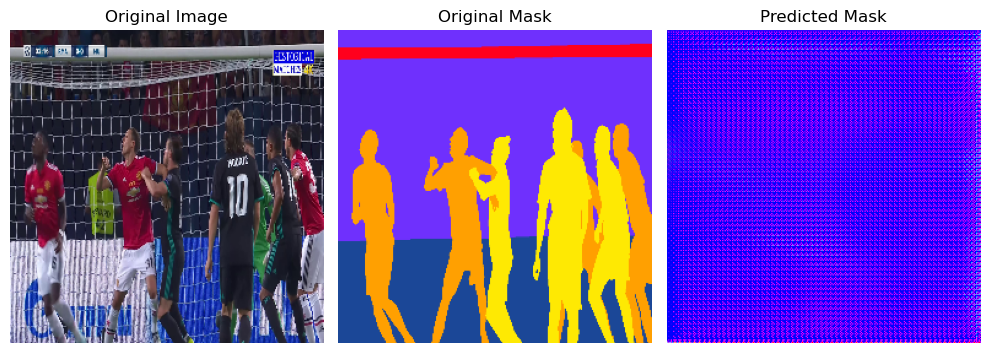

Epoch 2/100
25/25 [==============================] - 7s 272ms/step - loss: 0.6309 - accuracy: 0.7199 - val_loss: 5.5546 - val_accuracy: 0.4799


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 0.9s


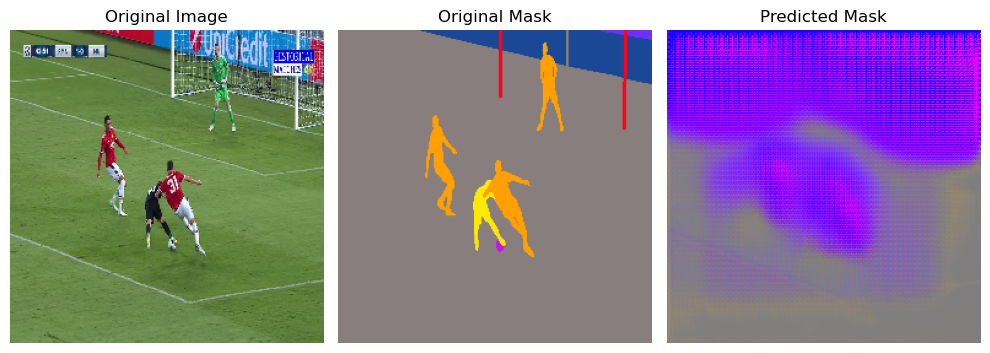

Epoch 3/100
25/25 [==============================] - 7s 279ms/step - loss: 0.6081 - accuracy: 0.7804 - val_loss: 2.0869 - val_accuracy: 0.4469


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 0.9s


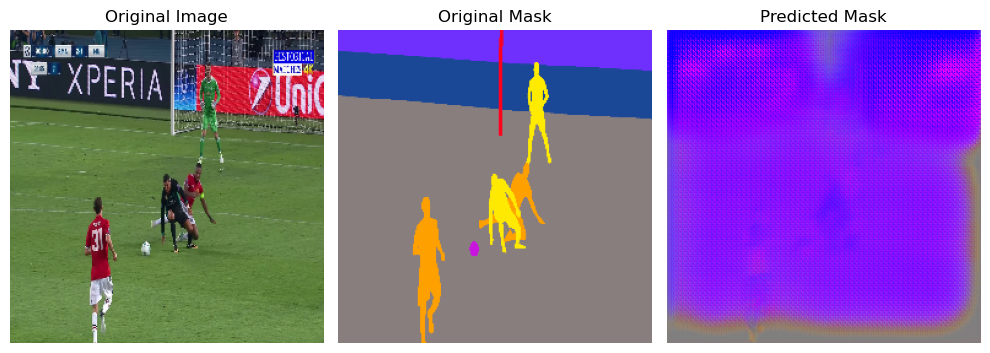

Epoch 4/100
25/25 [==============================] - 7s 276ms/step - loss: 0.5921 - accuracy: 0.7783 - val_loss: 0.6507 - val_accuracy: 0.9398


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 0.9s


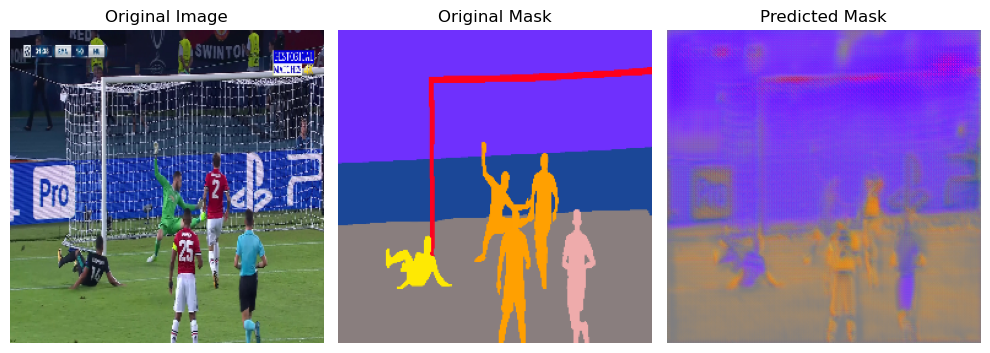

Epoch 5/100
25/25 [==============================] - 7s 273ms/step - loss: 0.5870 - accuracy: 0.8434 - val_loss: 0.6523 - val_accuracy: 0.9547


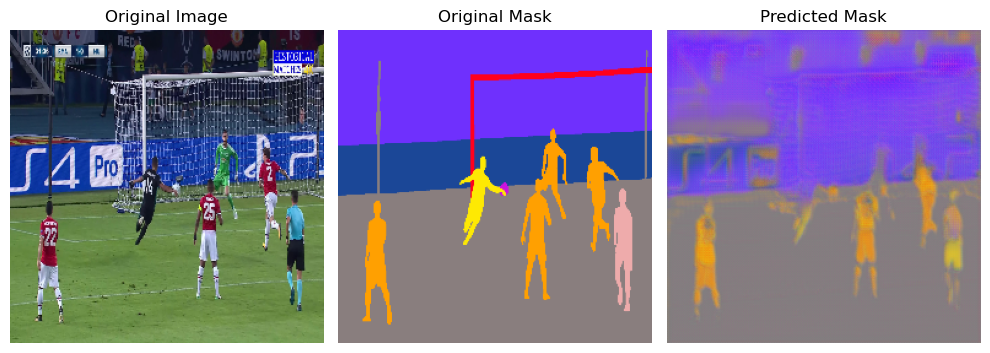

Epoch 6/100
25/25 [==============================] - 7s 276ms/step - loss: 0.5694 - accuracy: 0.8702 - val_loss: 0.6580 - val_accuracy: 0.7291


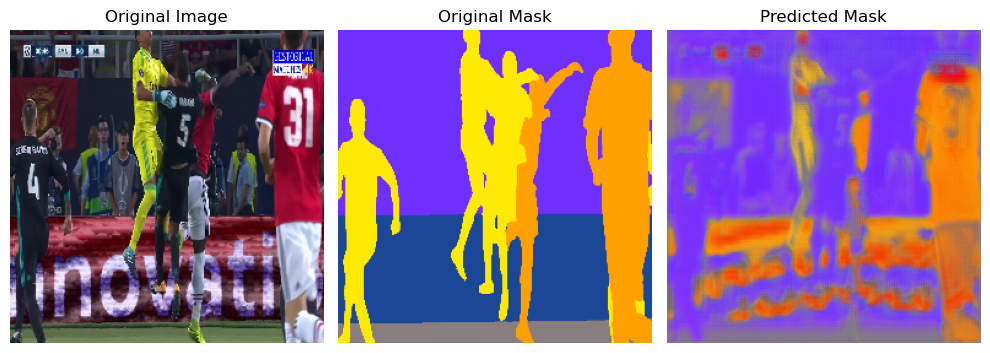

Epoch 7/100
25/25 [==============================] - 7s 275ms/step - loss: 0.5666 - accuracy: 0.8923 - val_loss: 0.6614 - val_accuracy: 0.8840


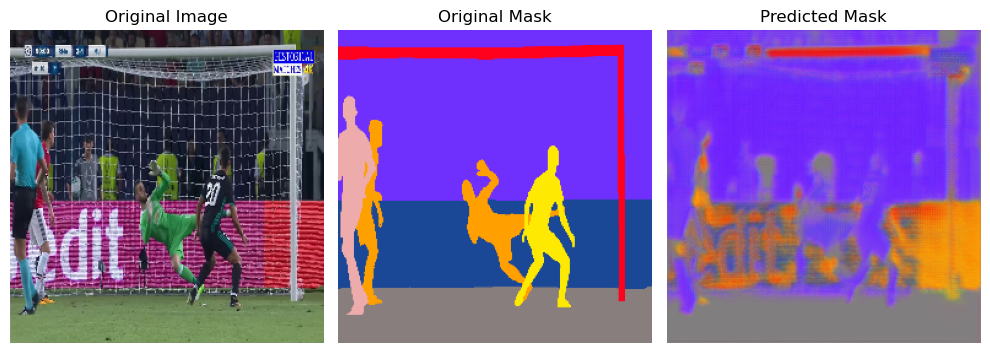

Epoch 8/100
25/25 [==============================] - 7s 278ms/step - loss: 0.5498 - accuracy: 0.8958 - val_loss: 0.6424 - val_accuracy: 0.9167


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 0.9s


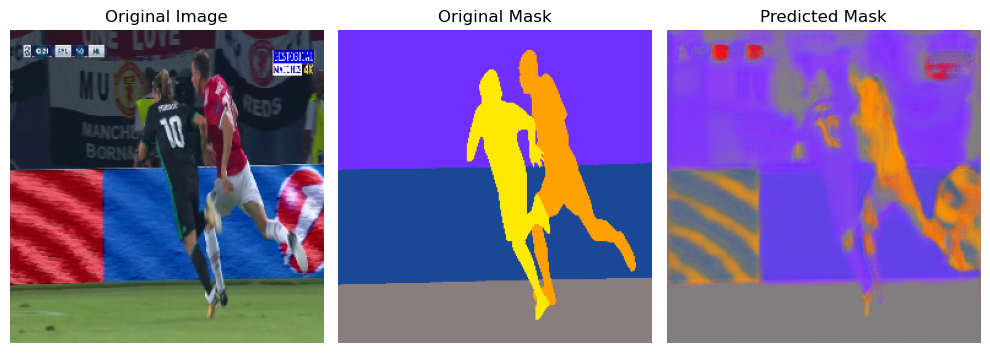

Epoch 9/100
25/25 [==============================] - 7s 275ms/step - loss: 0.5538 - accuracy: 0.9308 - val_loss: 0.6310 - val_accuracy: 0.9283


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 1.0s


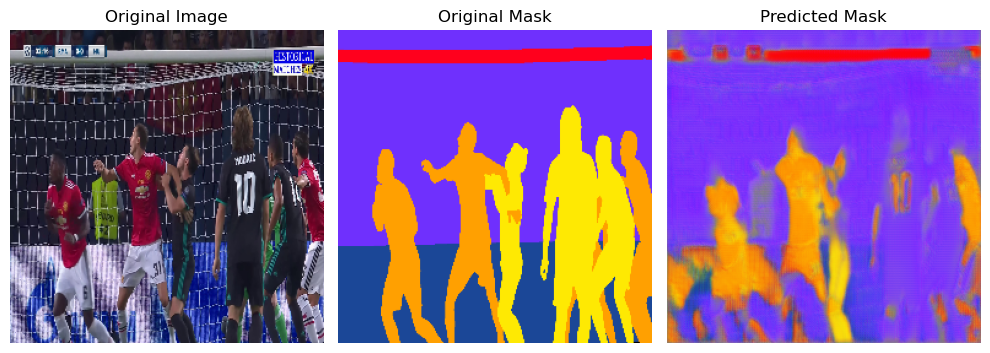

Epoch 10/100
25/25 [==============================] - 7s 273ms/step - loss: 0.5501 - accuracy: 0.9144 - val_loss: 0.6398 - val_accuracy: 0.5493


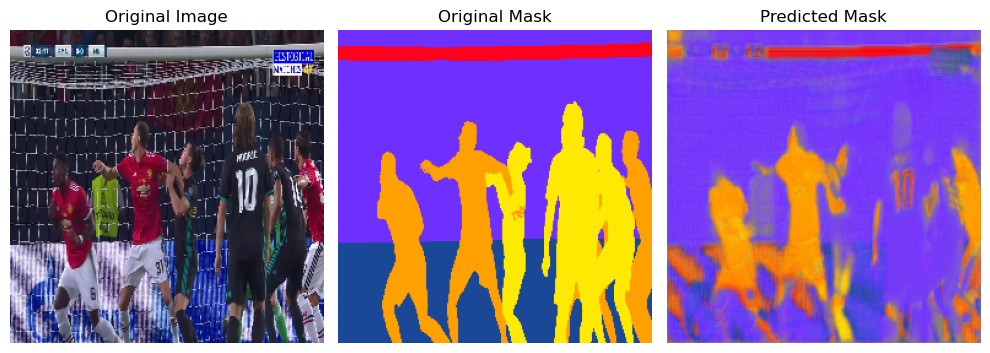

Epoch 11/100
25/25 [==============================] - 7s 272ms/step - loss: 0.5316 - accuracy: 0.9386 - val_loss: 0.6228 - val_accuracy: 0.9175


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 0.9s


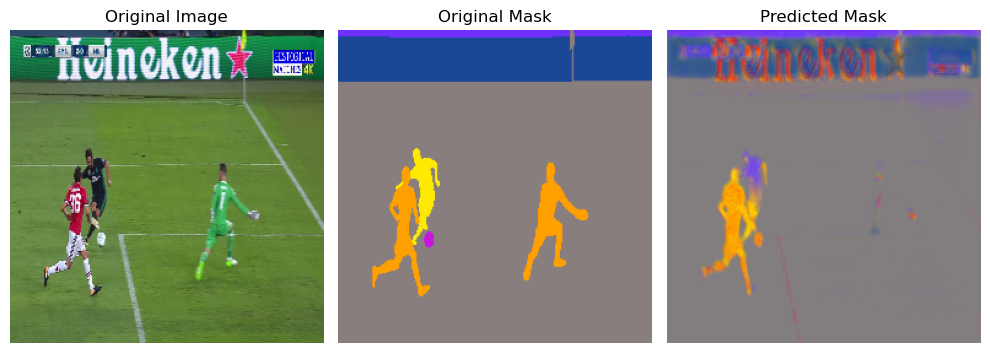

Epoch 12/100
25/25 [==============================] - 7s 273ms/step - loss: 0.5567 - accuracy: 0.9485 - val_loss: 0.6394 - val_accuracy: 0.5178


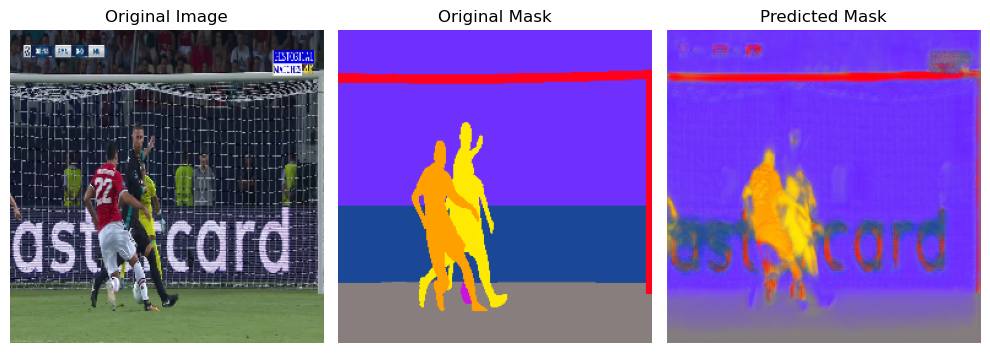

Epoch 13/100
25/25 [==============================] - 7s 274ms/step - loss: 0.5359 - accuracy: 0.9309 - val_loss: 0.6068 - val_accuracy: 0.9677


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 0.9s


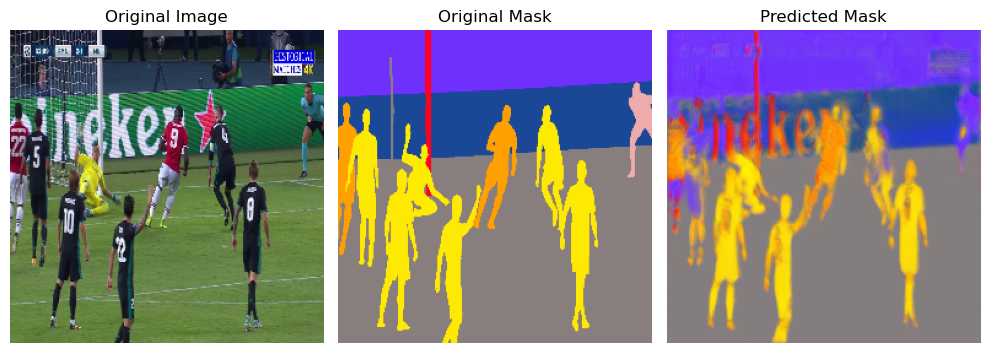

Epoch 14/100
25/25 [==============================] - 7s 277ms/step - loss: 0.5089 - accuracy: 0.9579 - val_loss: 0.6093 - val_accuracy: 0.9624


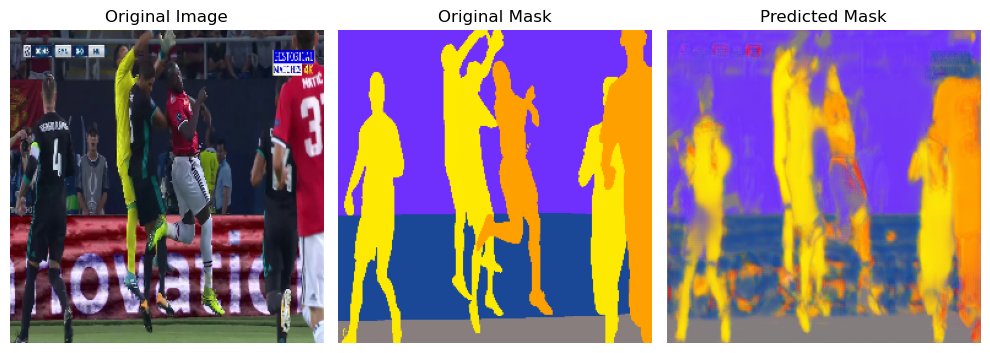

Epoch 15/100
25/25 [==============================] - 7s 273ms/step - loss: 0.5321 - accuracy: 0.9614 - val_loss: 0.5965 - val_accuracy: 0.9844


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 0.9s


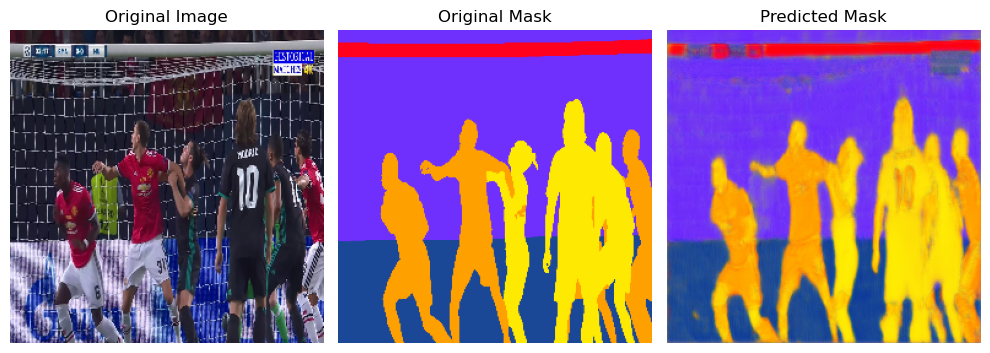

Epoch 16/100
25/25 [==============================] - 7s 279ms/step - loss: 0.5219 - accuracy: 0.9585 - val_loss: 0.5955 - val_accuracy: 0.9832


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 0.9s


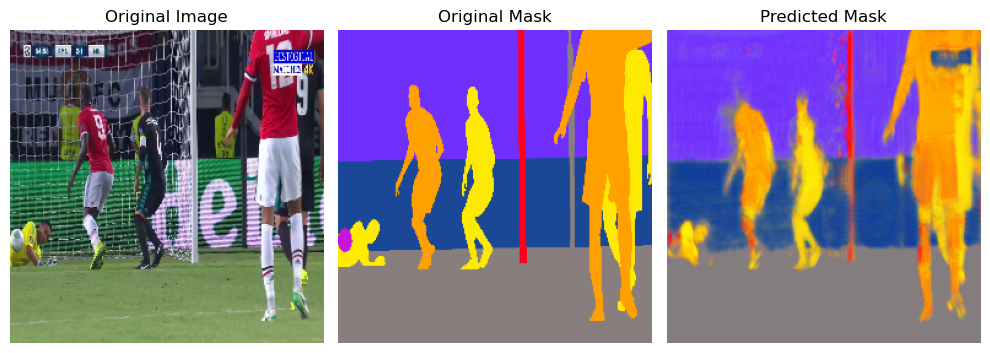

Epoch 17/100
25/25 [==============================] - 7s 278ms/step - loss: 0.5147 - accuracy: 0.9647 - val_loss: 0.5947 - val_accuracy: 0.9647


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 1.0s


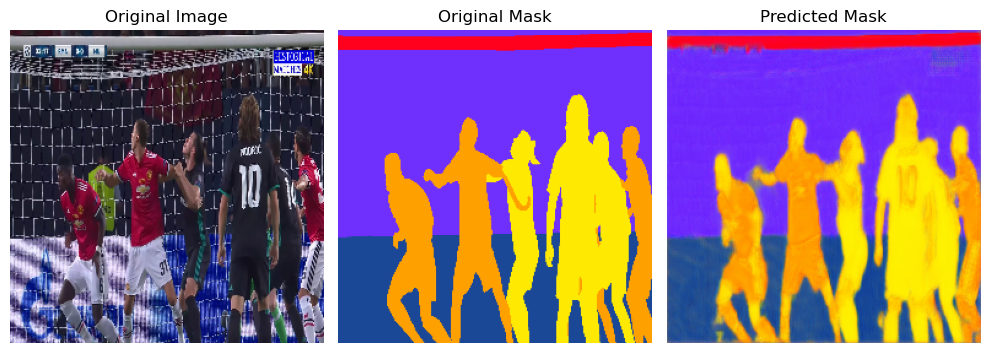

Epoch 18/100
25/25 [==============================] - 7s 274ms/step - loss: 0.5365 - accuracy: 0.9557 - val_loss: 0.6005 - val_accuracy: 0.9799


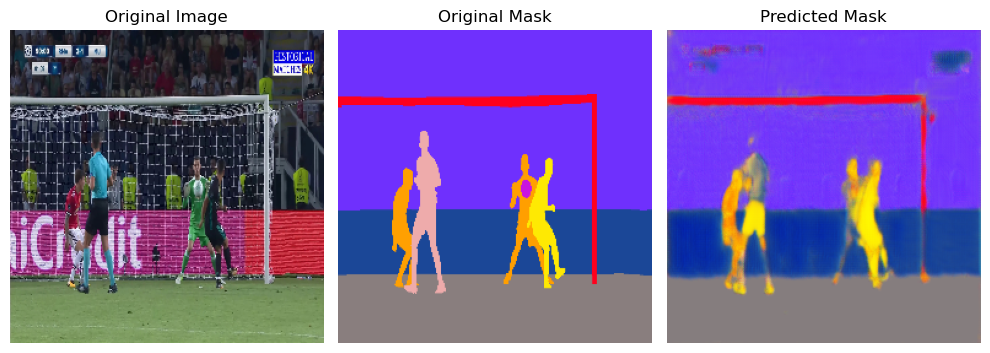

Epoch 19/100
25/25 [==============================] - 7s 279ms/step - loss: 0.5062 - accuracy: 0.9566 - val_loss: 0.5925 - val_accuracy: 0.9848


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 0.9s


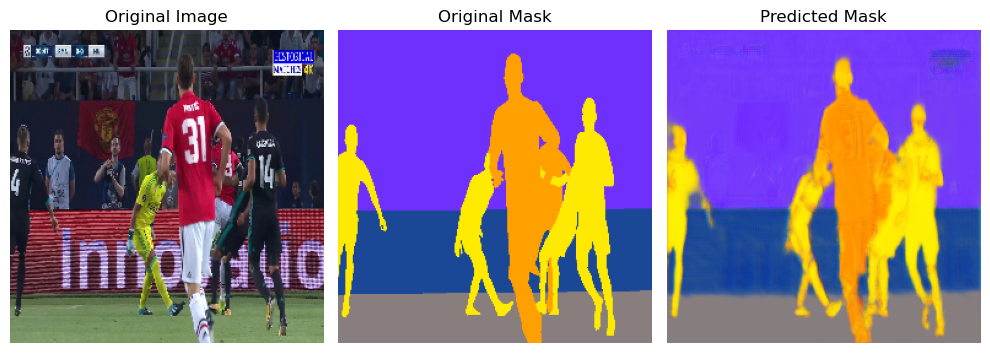

Epoch 20/100
25/25 [==============================] - 7s 278ms/step - loss: 0.5242 - accuracy: 0.9700 - val_loss: 0.5922 - val_accuracy: 0.9816


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 0.9s


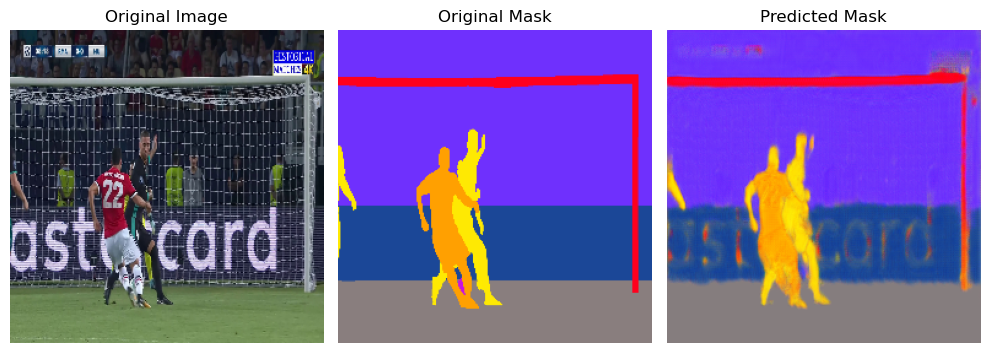

Epoch 21/100
25/25 [==============================] - 7s 278ms/step - loss: 0.5156 - accuracy: 0.9699 - val_loss: 0.5909 - val_accuracy: 0.9829


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 0.9s


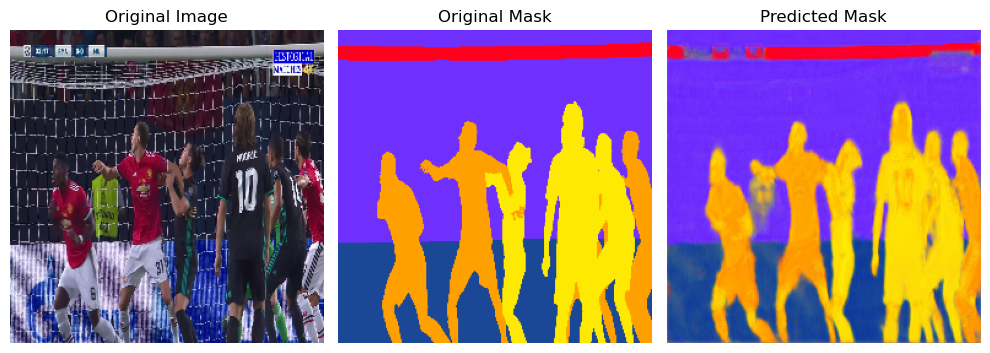

Epoch 22/100
25/25 [==============================] - 7s 275ms/step - loss: 0.5338 - accuracy: 0.9618 - val_loss: 0.5935 - val_accuracy: 0.9667


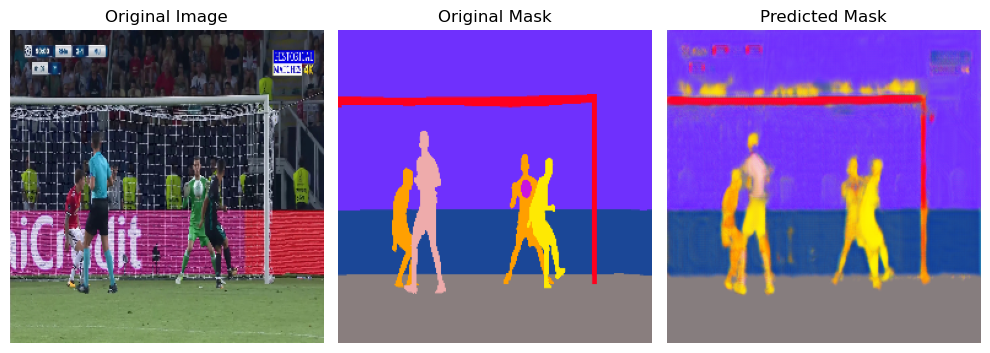

Epoch 23/100
25/25 [==============================] - 7s 267ms/step - loss: 0.5047 - accuracy: 0.9714 - val_loss: 0.5943 - val_accuracy: 0.9636


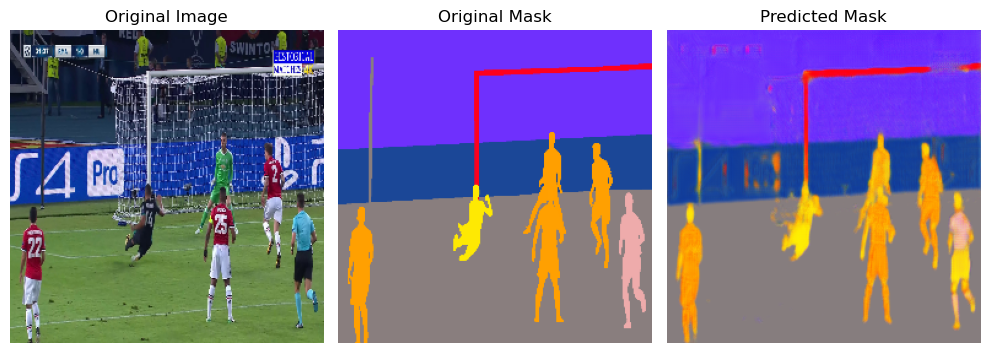

Epoch 24/100
25/25 [==============================] - 7s 281ms/step - loss: 0.5320 - accuracy: 0.9761 - val_loss: 0.5894 - val_accuracy: 0.9848


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 0.9s


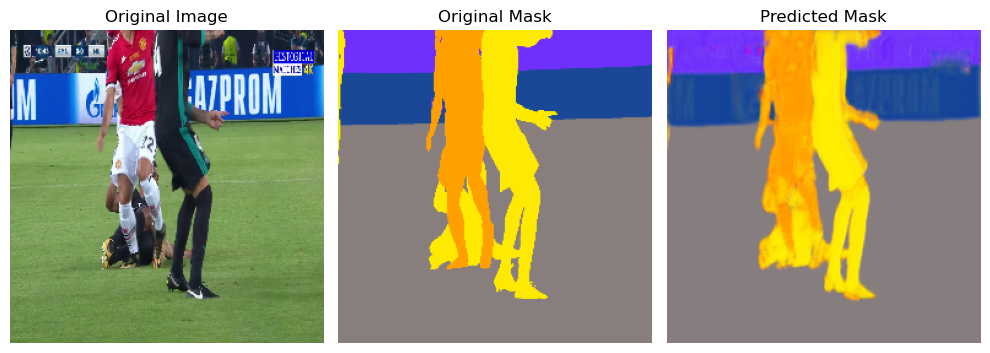

Epoch 25/100
25/25 [==============================] - 7s 279ms/step - loss: 0.5124 - accuracy: 0.9739 - val_loss: 0.5898 - val_accuracy: 0.9881


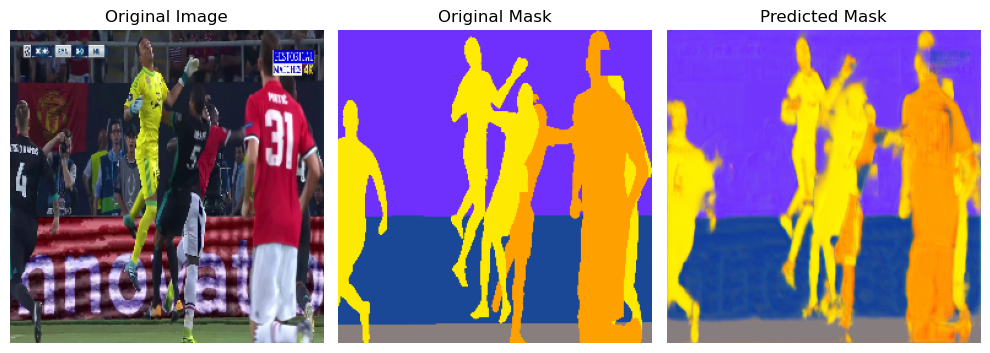

Epoch 26/100
25/25 [==============================] - 7s 272ms/step - loss: 0.5254 - accuracy: 0.9681 - val_loss: 0.5908 - val_accuracy: 0.9825


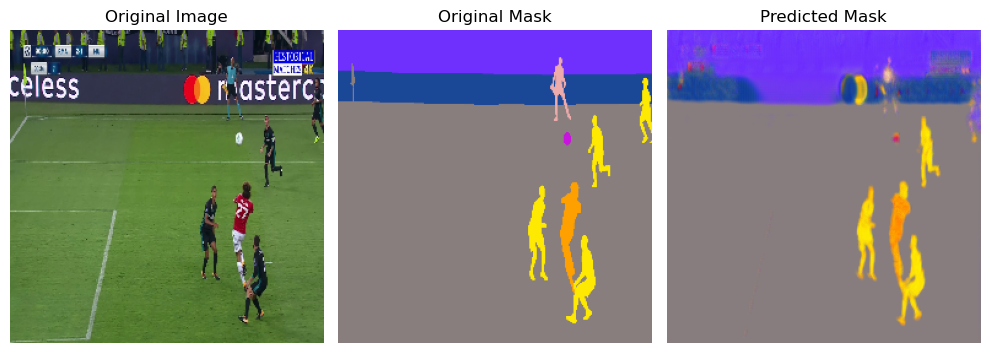

Epoch 27/100
25/25 [==============================] - 7s 276ms/step - loss: 0.5314 - accuracy: 0.9677 - val_loss: 0.6042 - val_accuracy: 0.9743


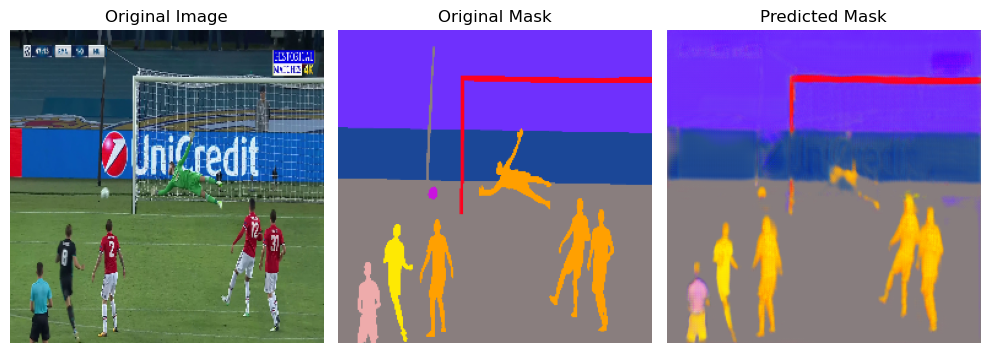

Epoch 28/100
25/25 [==============================] - 7s 275ms/step - loss: 0.5046 - accuracy: 0.9666 - val_loss: 0.5936 - val_accuracy: 0.9813


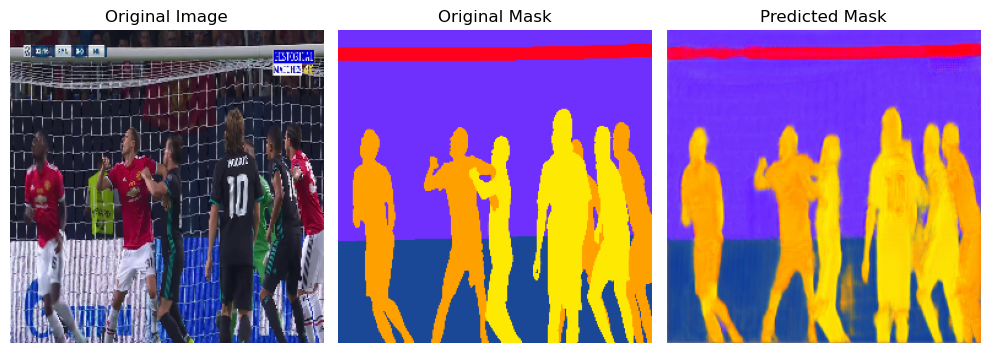

Epoch 29/100
25/25 [==============================] - 7s 282ms/step - loss: 0.5113 - accuracy: 0.9731 - val_loss: 0.5895 - val_accuracy: 0.9881


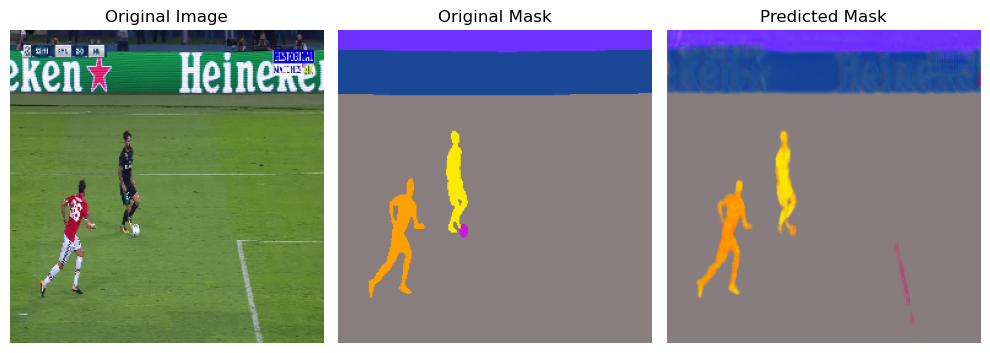

Epoch 30/100
25/25 [==============================] - 7s 277ms/step - loss: 0.5139 - accuracy: 0.9771 - val_loss: 0.5880 - val_accuracy: 0.9873


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 0.9s


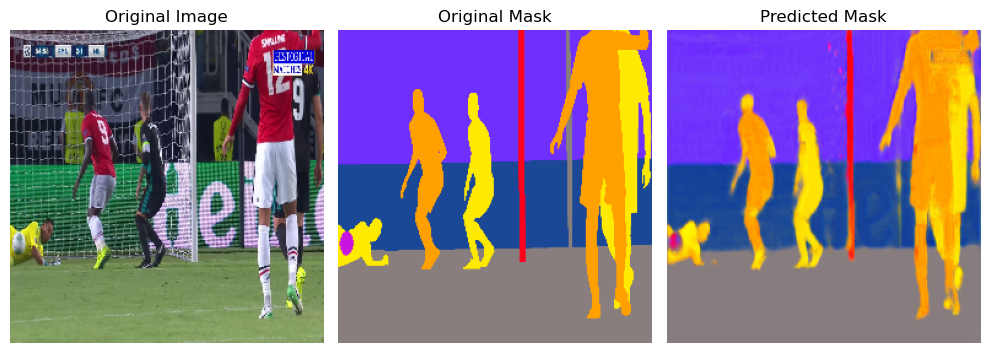

Epoch 31/100
25/25 [==============================] - 7s 279ms/step - loss: 0.5144 - accuracy: 0.9785 - val_loss: 0.5876 - val_accuracy: 0.9874


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 1.0s


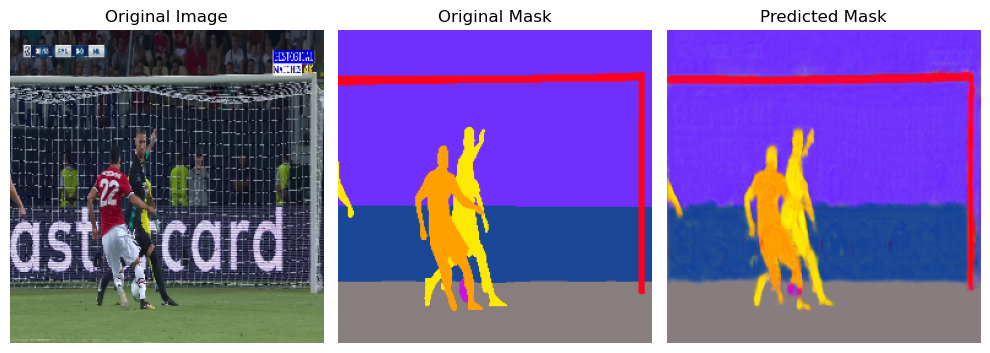

Epoch 32/100
25/25 [==============================] - 7s 282ms/step - loss: 0.4946 - accuracy: 0.9756 - val_loss: 0.5882 - val_accuracy: 0.9869


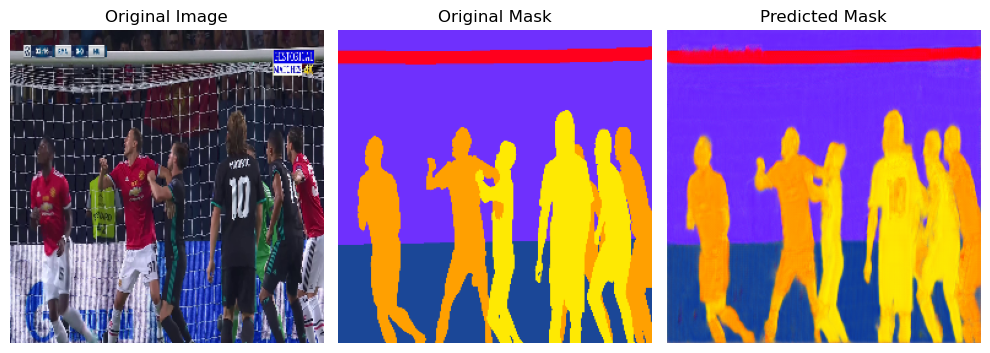

Epoch 33/100
25/25 [==============================] - 7s 277ms/step - loss: 0.5194 - accuracy: 0.9769 - val_loss: 0.5868 - val_accuracy: 0.9882


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 0.9s


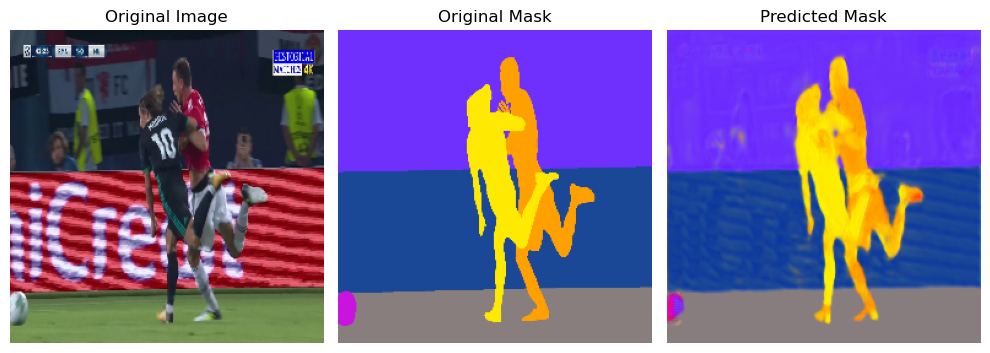

Epoch 34/100
25/25 [==============================] - 7s 277ms/step - loss: 0.4911 - accuracy: 0.9802 - val_loss: 0.5865 - val_accuracy: 0.9867


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 0.9s


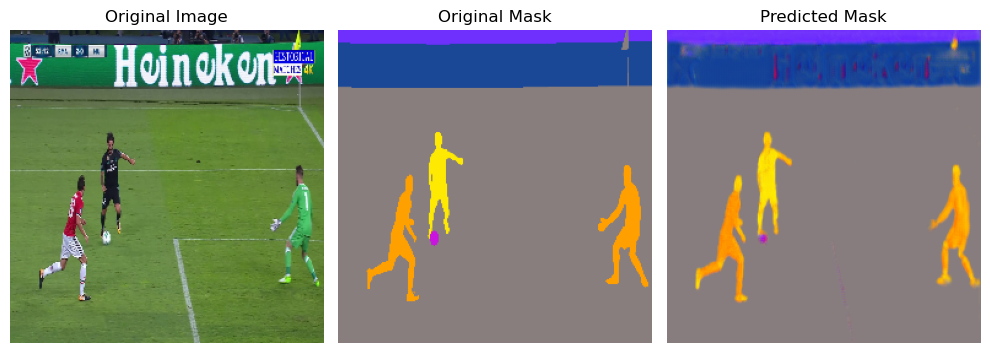

Epoch 35/100
25/25 [==============================] - 7s 276ms/step - loss: 0.5082 - accuracy: 0.9792 - val_loss: 0.5862 - val_accuracy: 0.9894


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 0.9s


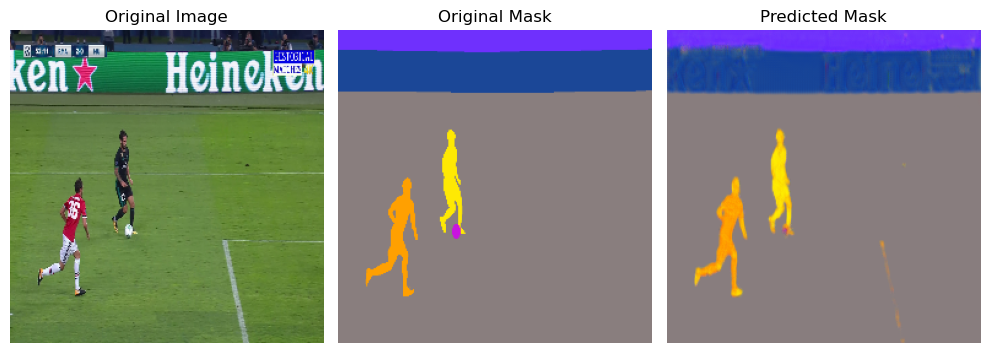

Epoch 36/100
25/25 [==============================] - 7s 281ms/step - loss: 0.5022 - accuracy: 0.9782 - val_loss: 0.5928 - val_accuracy: 0.9818


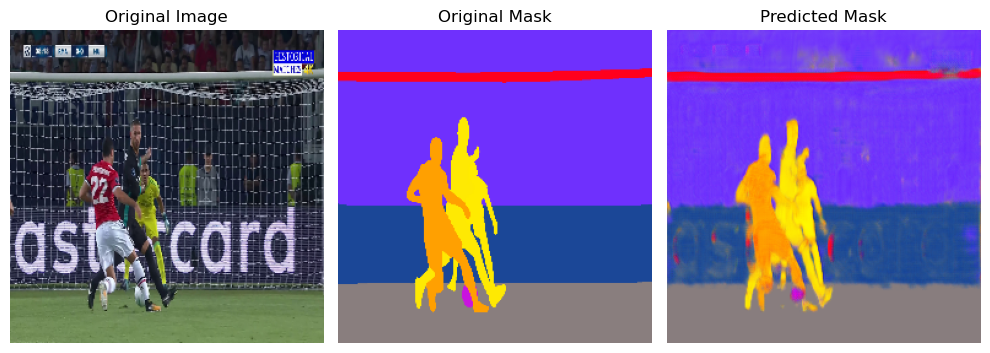

Epoch 37/100
25/25 [==============================] - 7s 274ms/step - loss: 0.5144 - accuracy: 0.9787 - val_loss: 0.5876 - val_accuracy: 0.9860


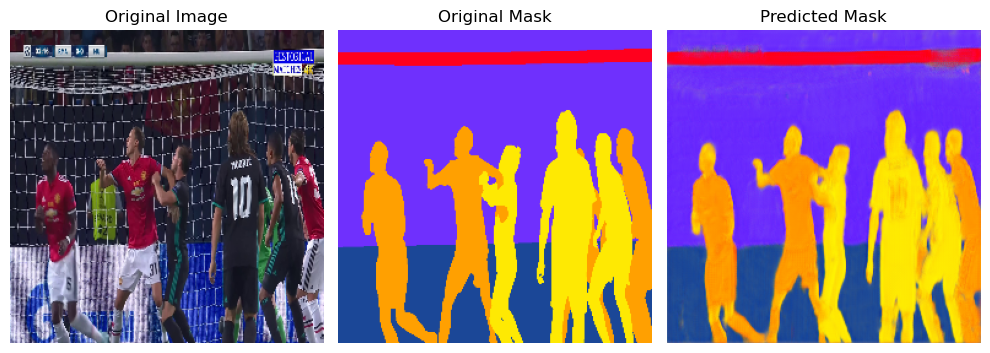

Epoch 38/100
25/25 [==============================] - 7s 274ms/step - loss: 0.5018 - accuracy: 0.9781 - val_loss: 0.5886 - val_accuracy: 0.9855


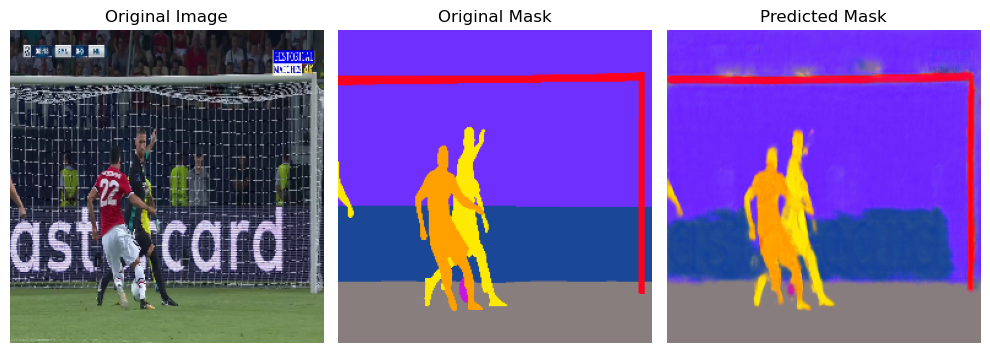

Epoch 39/100
25/25 [==============================] - 7s 279ms/step - loss: 0.4952 - accuracy: 0.9793 - val_loss: 0.5877 - val_accuracy: 0.9879


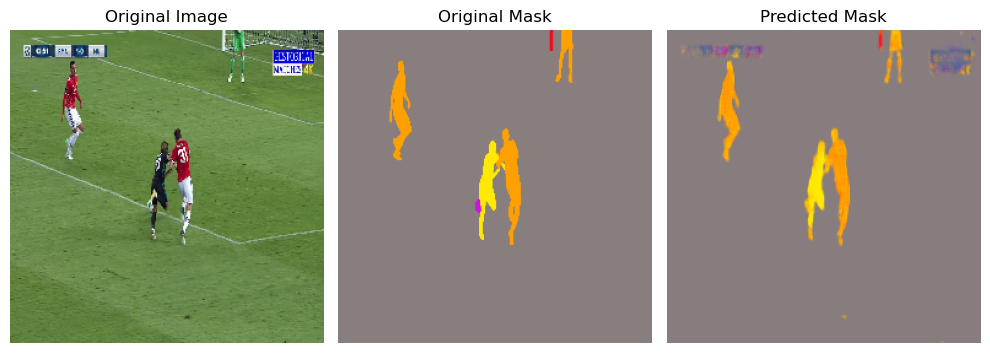

Epoch 40/100
25/25 [==============================] - 7s 282ms/step - loss: 0.5065 - accuracy: 0.9818 - val_loss: 0.5862 - val_accuracy: 0.9875


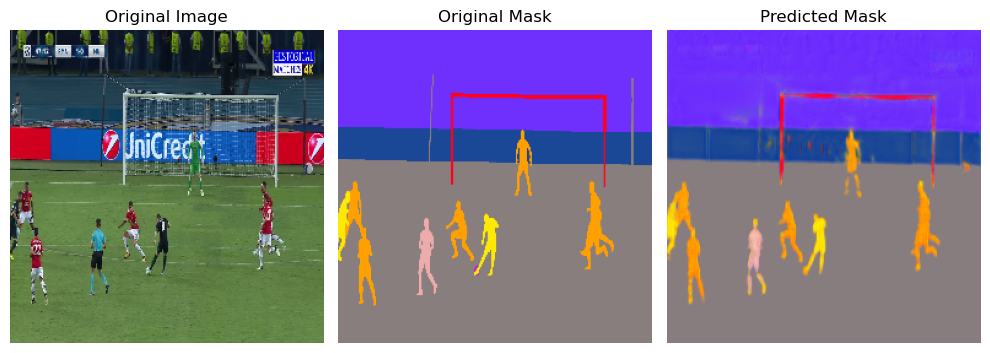

Epoch 41/100
25/25 [==============================] - 7s 281ms/step - loss: 0.5111 - accuracy: 0.9819 - val_loss: 0.5849 - val_accuracy: 0.9879


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 1.0s


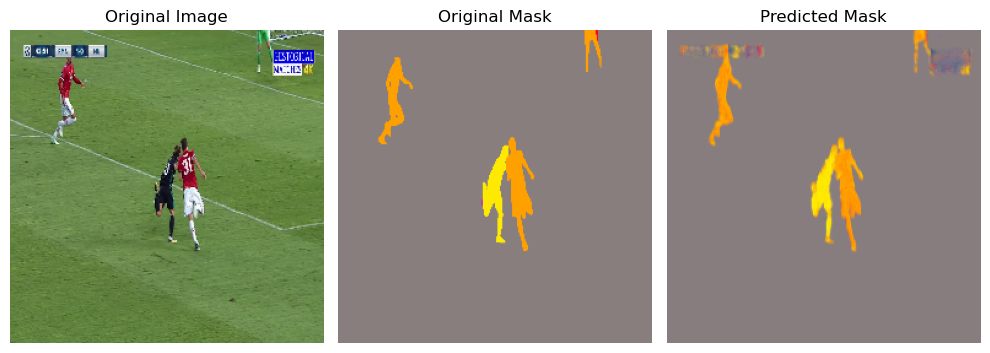

Epoch 42/100
25/25 [==============================] - 7s 278ms/step - loss: 0.5163 - accuracy: 0.9775 - val_loss: 0.5852 - val_accuracy: 0.9872


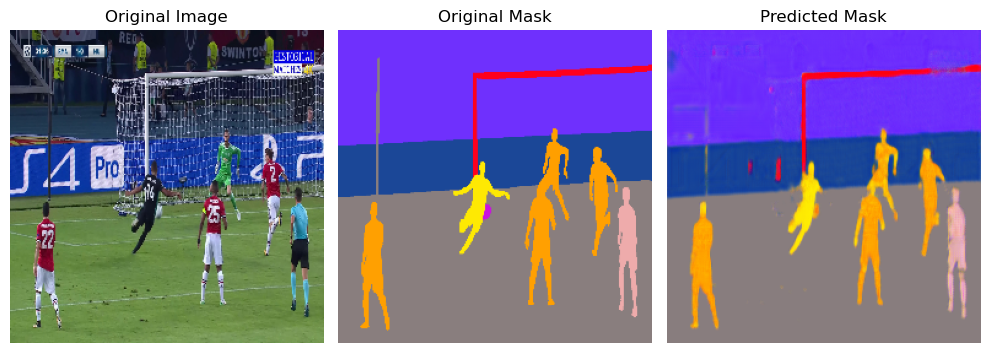

Epoch 43/100
25/25 [==============================] - 7s 280ms/step - loss: 0.5063 - accuracy: 0.9760 - val_loss: 0.5849 - val_accuracy: 0.9883


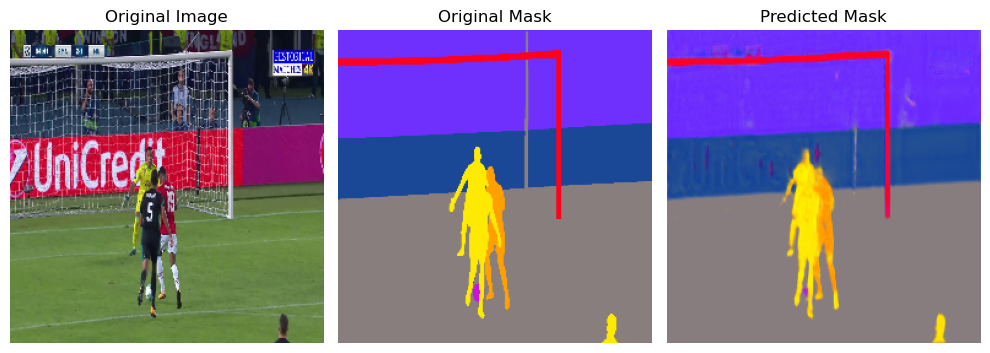

Epoch 44/100
25/25 [==============================] - 7s 273ms/step - loss: 0.5060 - accuracy: 0.9822 - val_loss: 0.5843 - val_accuracy: 0.9890


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 0.9s


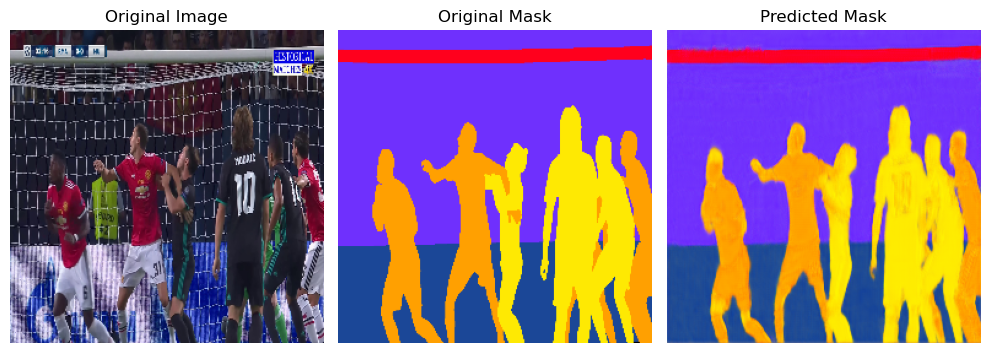

Epoch 45/100
25/25 [==============================] - 7s 266ms/step - loss: 0.4915 - accuracy: 0.9825 - val_loss: 0.5843 - val_accuracy: 0.9885


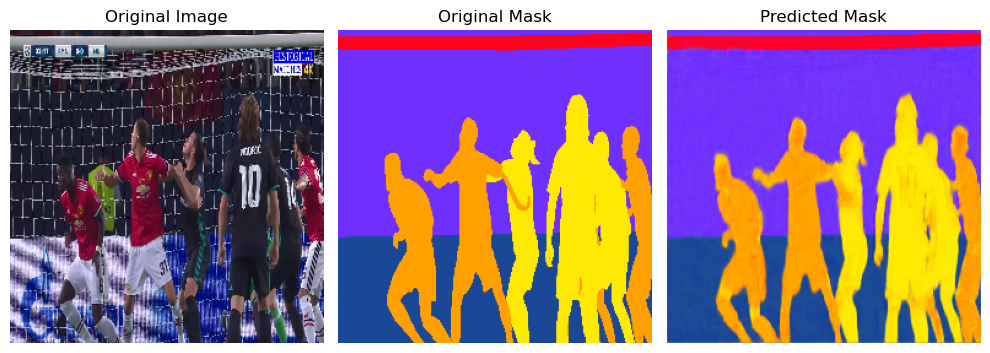

Epoch 46/100
25/25 [==============================] - 7s 263ms/step - loss: 0.4799 - accuracy: 0.9843 - val_loss: 0.5840 - val_accuracy: 0.9878


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 0.9s


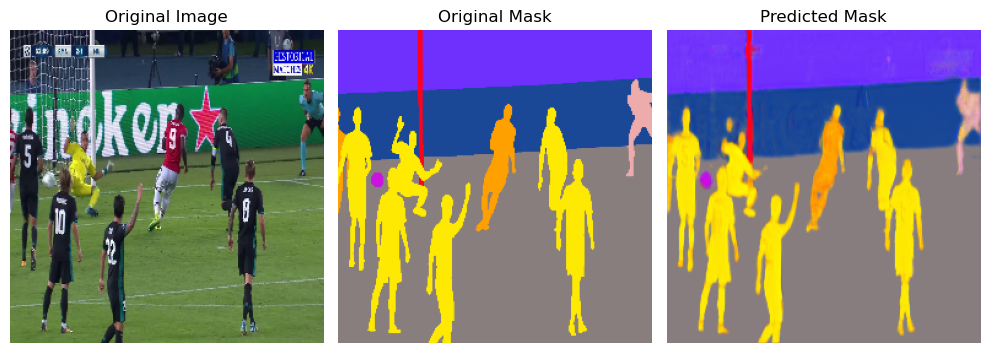

Epoch 47/100
25/25 [==============================] - 7s 272ms/step - loss: 0.5114 - accuracy: 0.9837 - val_loss: 0.5863 - val_accuracy: 0.9872


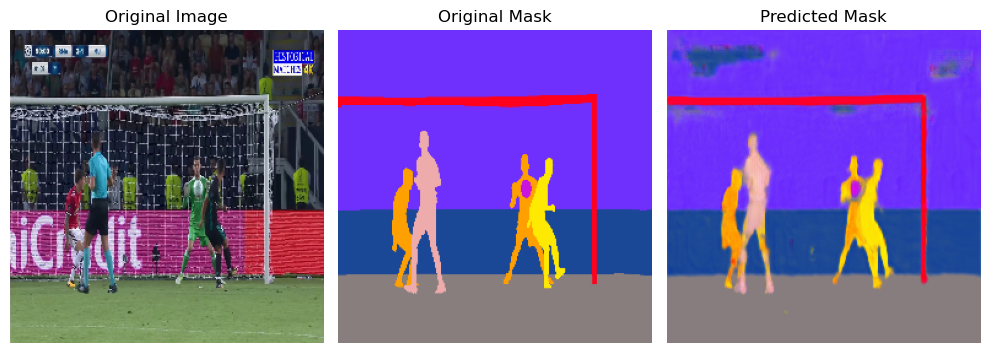

Epoch 48/100
25/25 [==============================] - 7s 269ms/step - loss: 0.4973 - accuracy: 0.9840 - val_loss: 0.5844 - val_accuracy: 0.9875


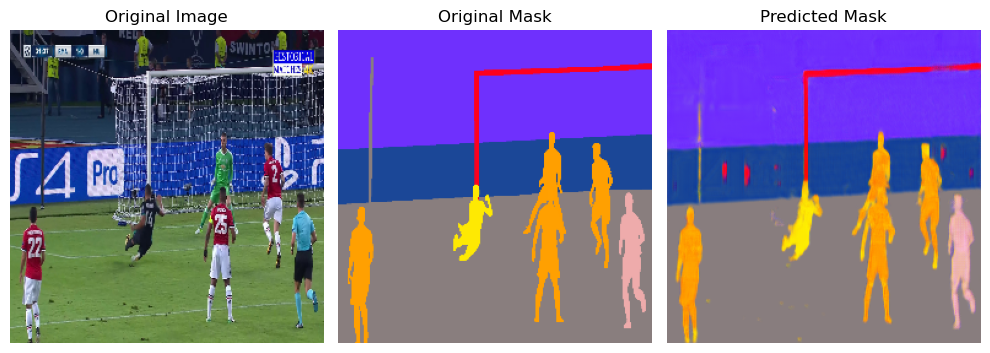

Epoch 49/100
25/25 [==============================] - 7s 270ms/step - loss: 0.5030 - accuracy: 0.9851 - val_loss: 0.5837 - val_accuracy: 0.9880


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 1.0s


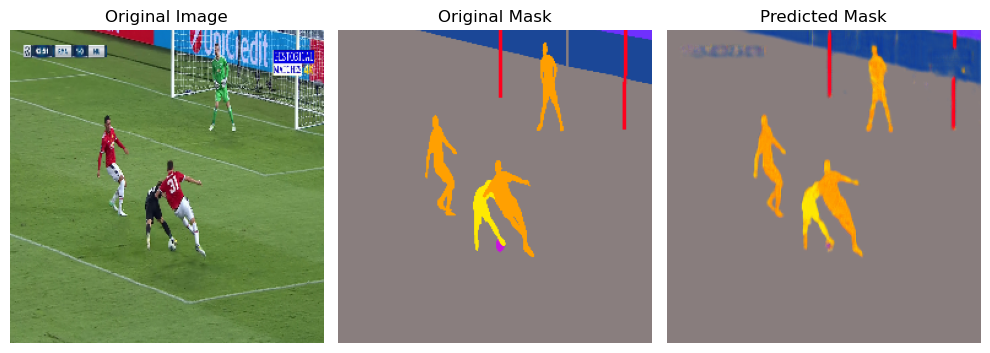

Epoch 50/100
25/25 [==============================] - 7s 269ms/step - loss: 0.4926 - accuracy: 0.9843 - val_loss: 0.5839 - val_accuracy: 0.9880


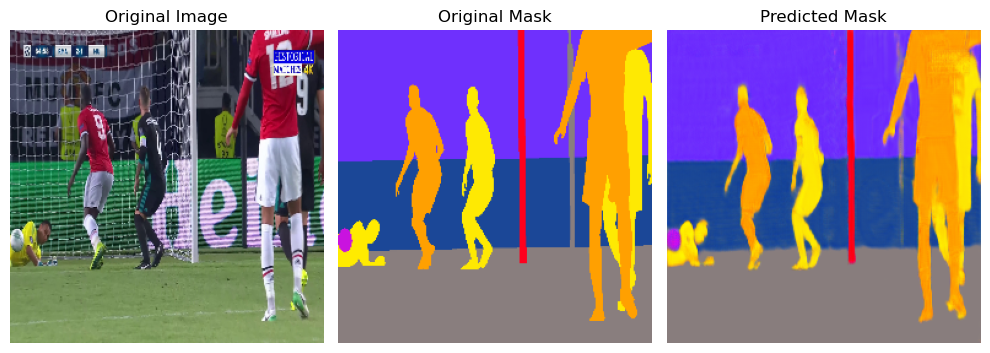

Epoch 51/100
25/25 [==============================] - 7s 270ms/step - loss: 0.4833 - accuracy: 0.9853 - val_loss: 0.5833 - val_accuracy: 0.9881


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 0.9s


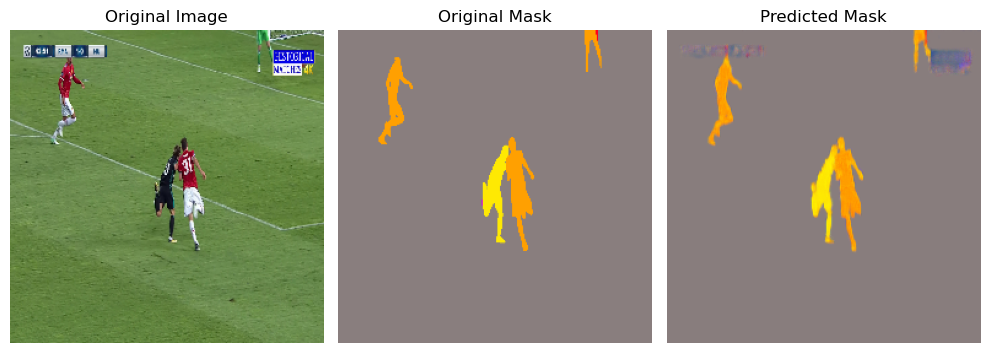

Epoch 52/100
25/25 [==============================] - 7s 274ms/step - loss: 0.5056 - accuracy: 0.9840 - val_loss: 0.5935 - val_accuracy: 0.9821


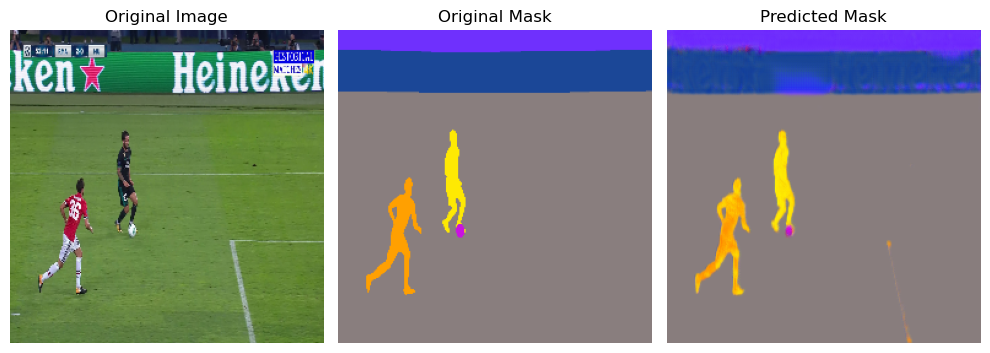

Epoch 53/100
25/25 [==============================] - 7s 279ms/step - loss: 0.5062 - accuracy: 0.9719 - val_loss: 0.9371 - val_accuracy: 0.9566


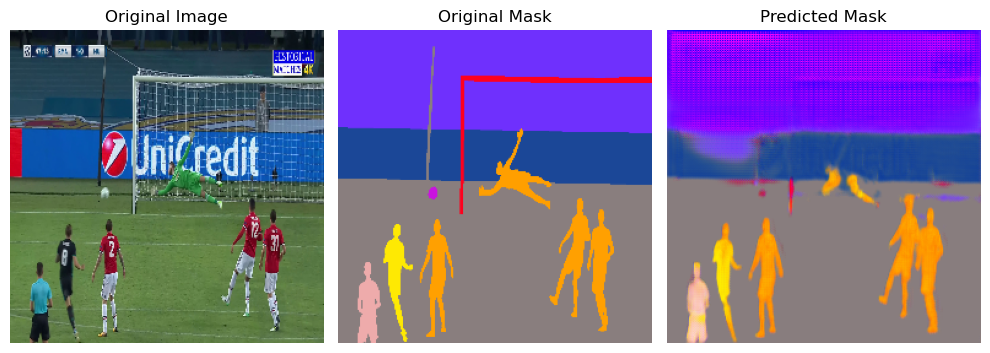

Epoch 54/100
25/25 [==============================] - 7s 279ms/step - loss: 0.5155 - accuracy: 0.9720 - val_loss: 0.7074 - val_accuracy: 0.9024


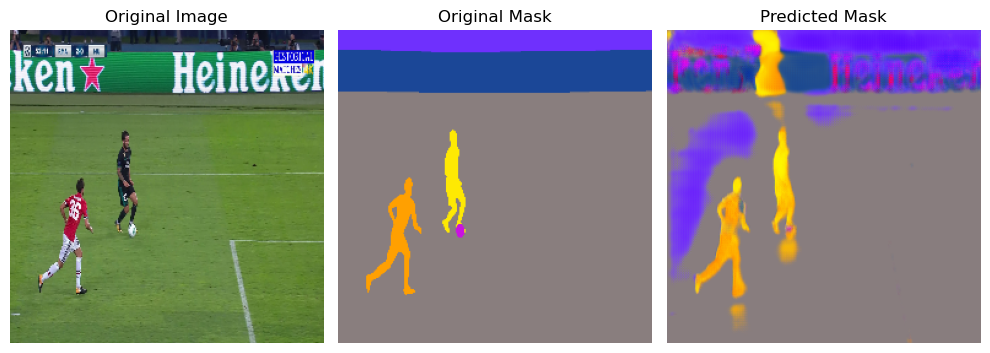

Epoch 55/100
25/25 [==============================] - 7s 278ms/step - loss: 0.5394 - accuracy: 0.9619 - val_loss: 0.6704 - val_accuracy: 0.9239


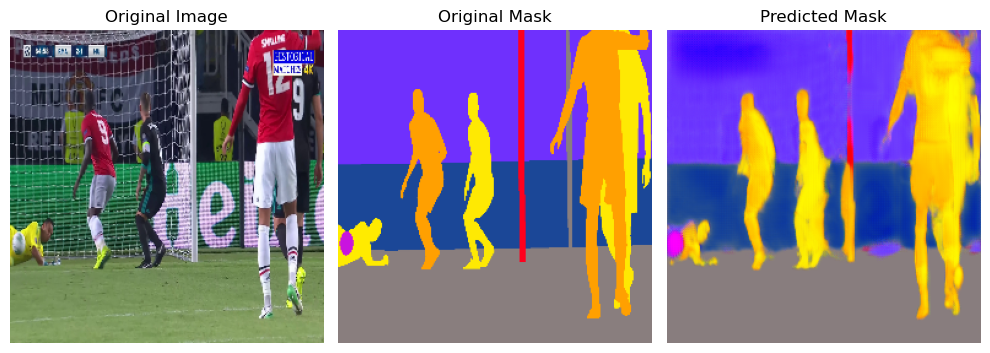

Epoch 56/100
25/25 [==============================] - 7s 279ms/step - loss: 0.5177 - accuracy: 0.9739 - val_loss: 0.5969 - val_accuracy: 0.9592


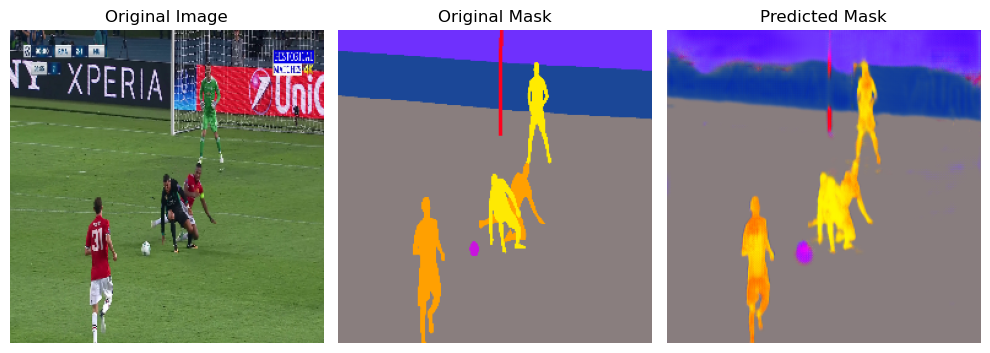

Epoch 57/100
25/25 [==============================] - 7s 277ms/step - loss: 0.5088 - accuracy: 0.9780 - val_loss: 0.5875 - val_accuracy: 0.9814


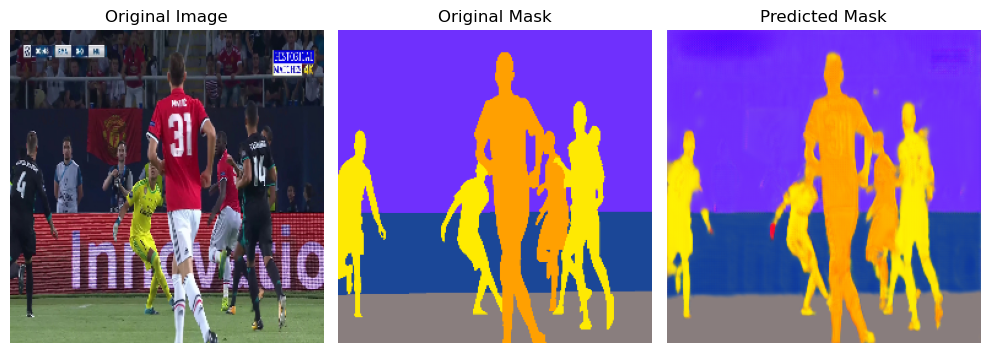

Epoch 58/100
25/25 [==============================] - 7s 282ms/step - loss: 0.5141 - accuracy: 0.9799 - val_loss: 0.5858 - val_accuracy: 0.9863


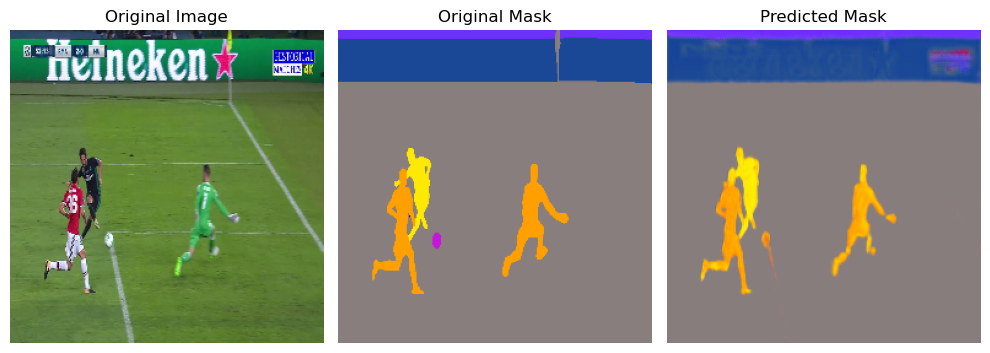

Epoch 59/100
25/25 [==============================] - 7s 276ms/step - loss: 0.4956 - accuracy: 0.9830 - val_loss: 0.5840 - val_accuracy: 0.9868


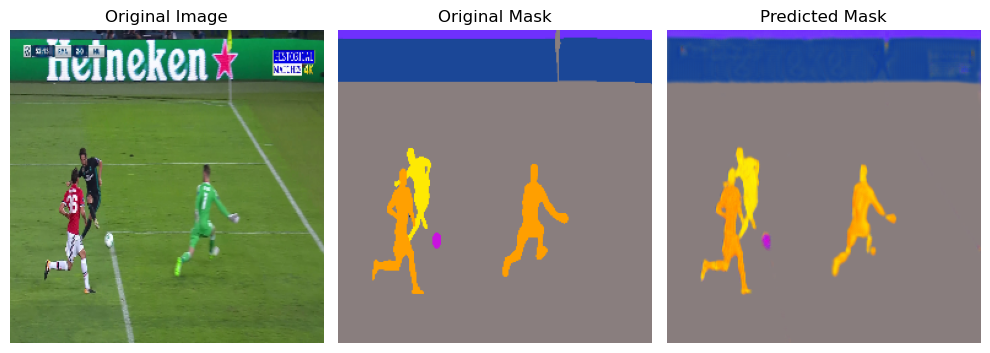

Epoch 60/100
25/25 [==============================] - 7s 283ms/step - loss: 0.4897 - accuracy: 0.9826 - val_loss: 0.5840 - val_accuracy: 0.9880


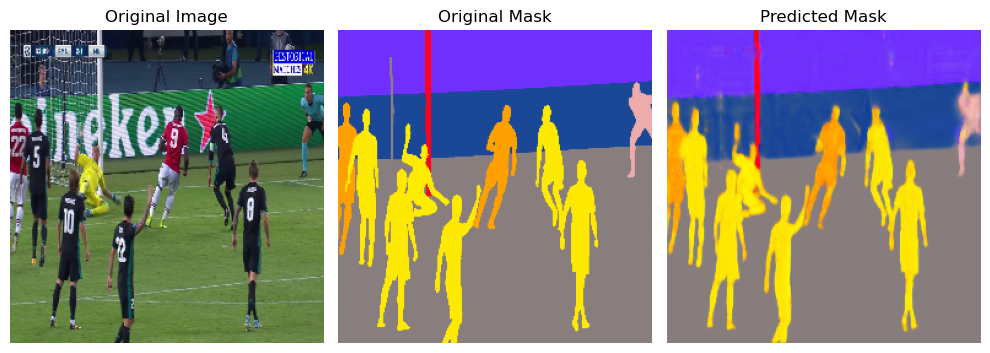

Epoch 61/100
25/25 [==============================] - 7s 278ms/step - loss: 0.5016 - accuracy: 0.9841 - val_loss: 0.5848 - val_accuracy: 0.9865


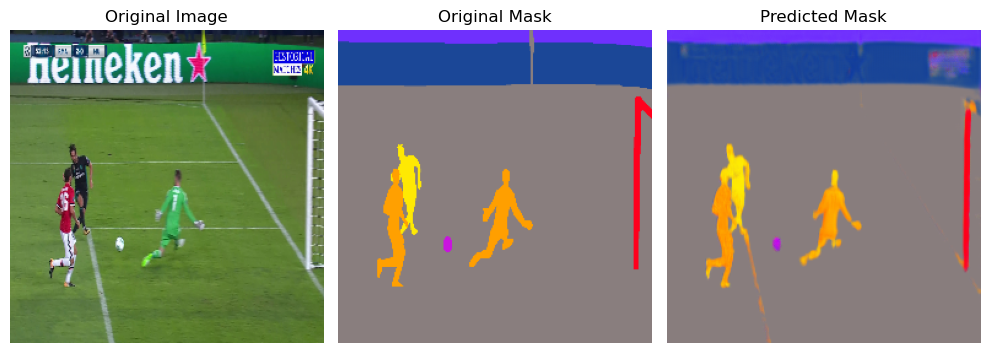

Epoch 62/100
25/25 [==============================] - 7s 280ms/step - loss: 0.5061 - accuracy: 0.9834 - val_loss: 0.5842 - val_accuracy: 0.9871


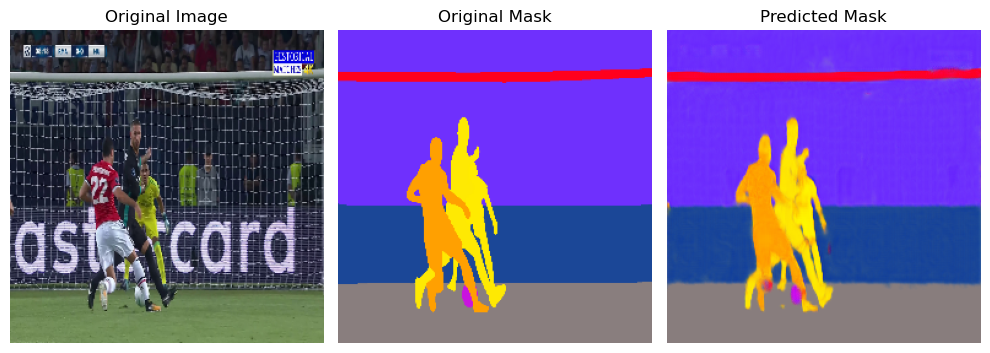

Epoch 63/100
25/25 [==============================] - 7s 275ms/step - loss: 0.4794 - accuracy: 0.9838 - val_loss: 0.5841 - val_accuracy: 0.9874


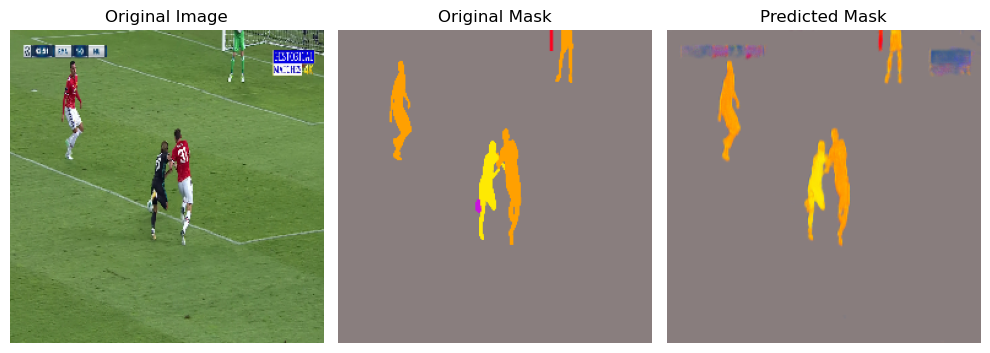

Epoch 64/100
25/25 [==============================] - 7s 274ms/step - loss: 0.5068 - accuracy: 0.9833 - val_loss: 0.5837 - val_accuracy: 0.9869


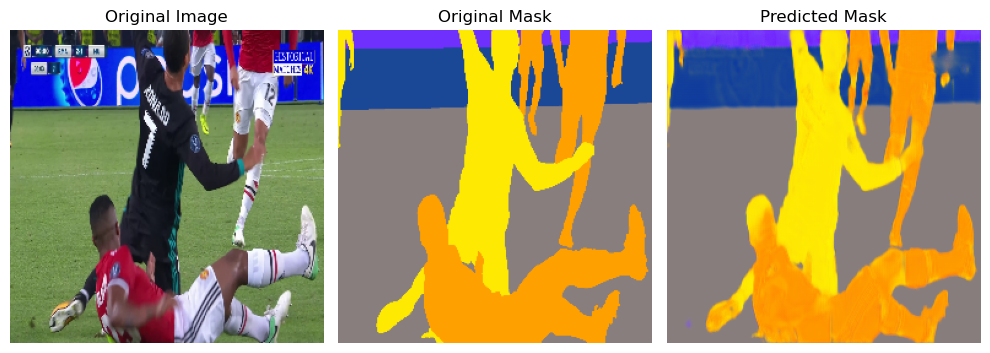

Epoch 65/100
25/25 [==============================] - 7s 277ms/step - loss: 0.5188 - accuracy: 0.9841 - val_loss: 0.5838 - val_accuracy: 0.9876


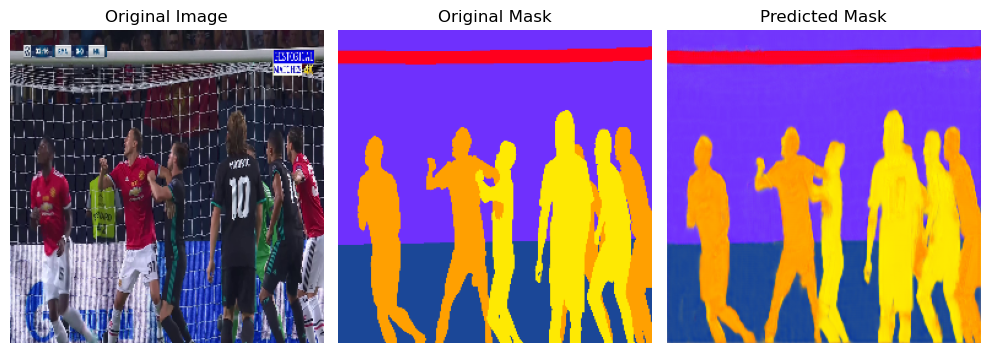

Epoch 66/100
25/25 [==============================] - 7s 277ms/step - loss: 0.5125 - accuracy: 0.9860 - val_loss: 0.5846 - val_accuracy: 0.9857


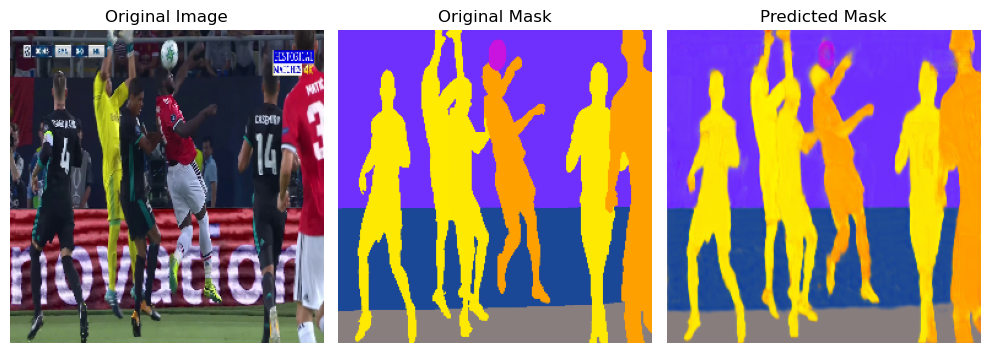

Epoch 67/100
25/25 [==============================] - 7s 279ms/step - loss: 0.4861 - accuracy: 0.9844 - val_loss: 0.5836 - val_accuracy: 0.9875


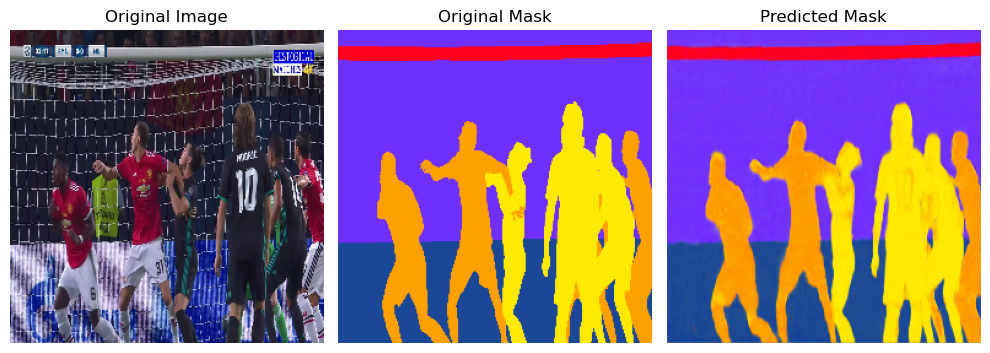

Epoch 68/100
25/25 [==============================] - 7s 276ms/step - loss: 0.4921 - accuracy: 0.9856 - val_loss: 0.5829 - val_accuracy: 0.9883


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 0.9s


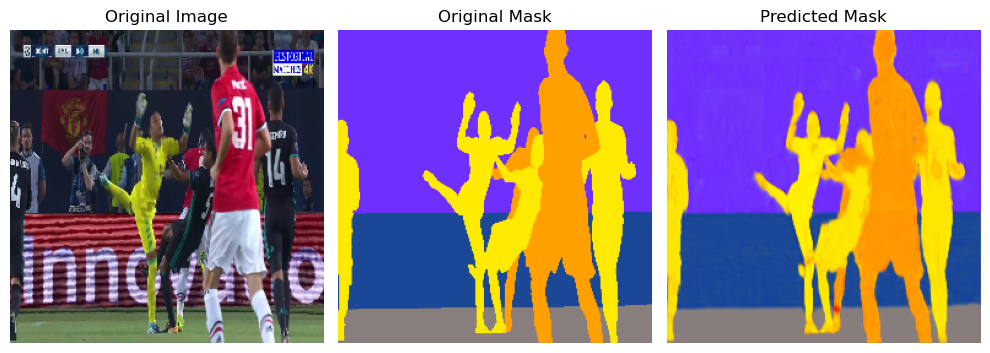

Epoch 69/100
25/25 [==============================] - 7s 263ms/step - loss: 0.5025 - accuracy: 0.9866 - val_loss: 0.5828 - val_accuracy: 0.9878


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 1.0s


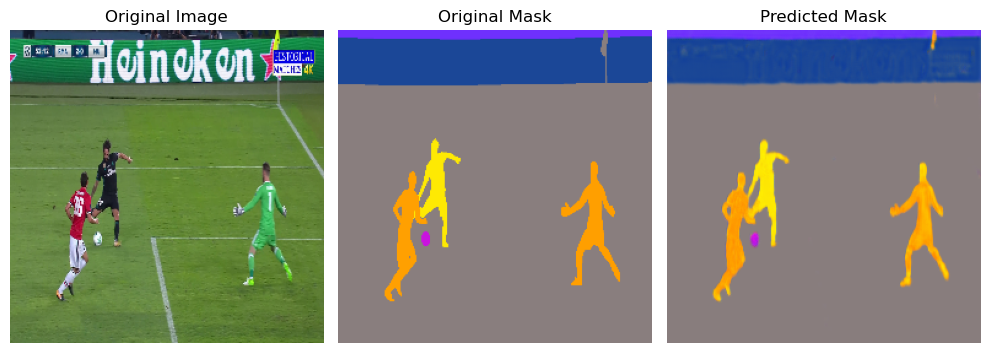

Epoch 70/100
25/25 [==============================] - 7s 266ms/step - loss: 0.4931 - accuracy: 0.9865 - val_loss: 0.5829 - val_accuracy: 0.9876


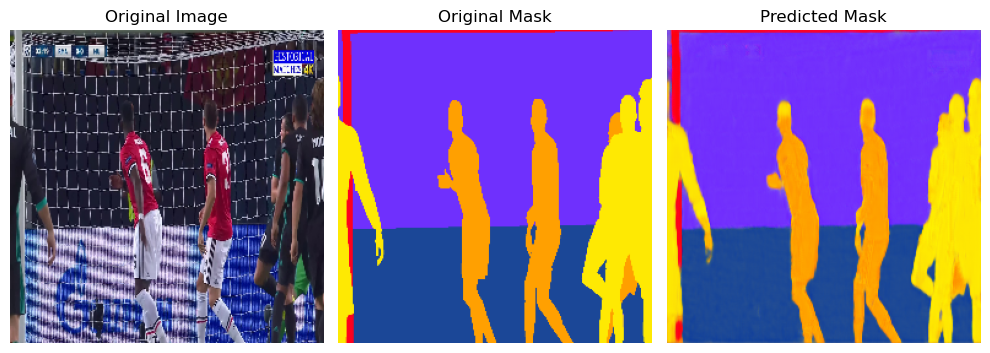

Epoch 71/100
25/25 [==============================] - 7s 268ms/step - loss: 0.4972 - accuracy: 0.9862 - val_loss: 0.5829 - val_accuracy: 0.9883


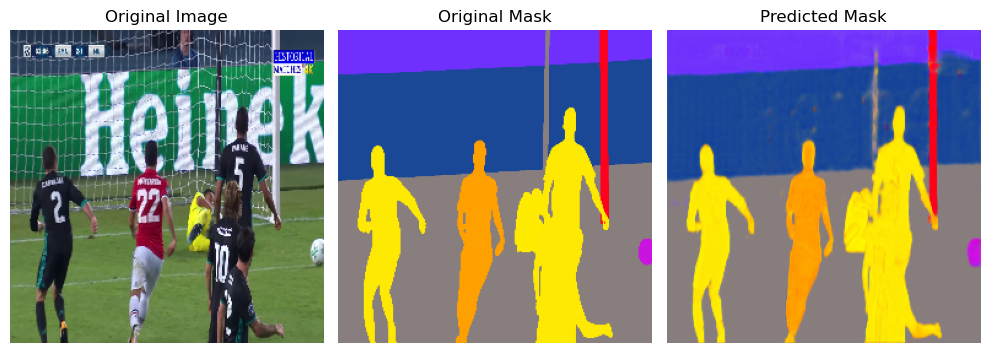

Epoch 72/100
25/25 [==============================] - 7s 268ms/step - loss: 0.5029 - accuracy: 0.9850 - val_loss: 0.5827 - val_accuracy: 0.9887


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 0.9s


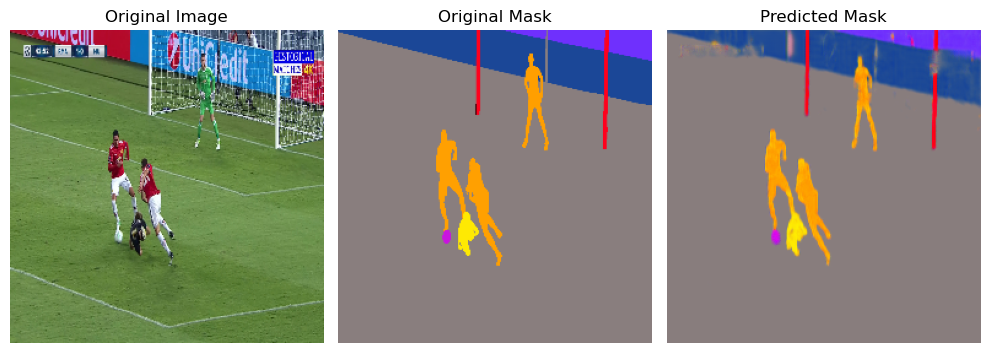

Epoch 73/100
25/25 [==============================] - 7s 266ms/step - loss: 0.5094 - accuracy: 0.9866 - val_loss: 0.5826 - val_accuracy: 0.9876


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 0.9s


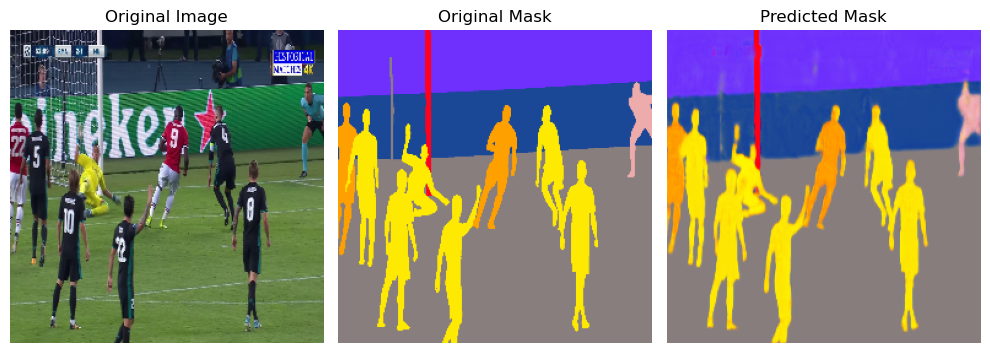

Epoch 74/100
25/25 [==============================] - 7s 266ms/step - loss: 0.5055 - accuracy: 0.9847 - val_loss: 0.5830 - val_accuracy: 0.9868


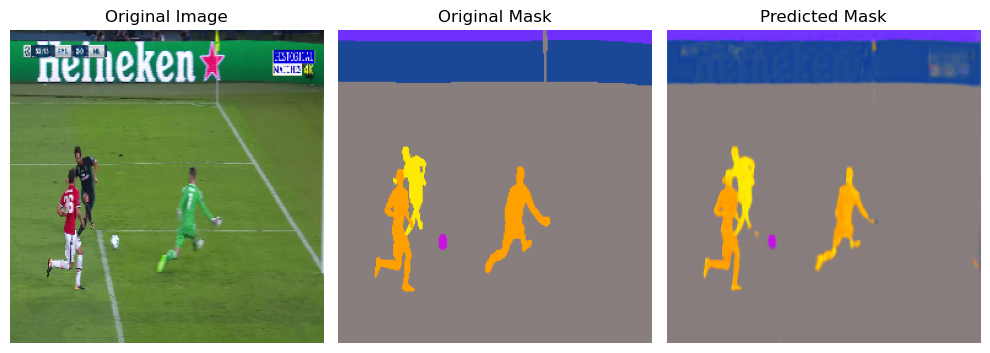

Epoch 75/100
25/25 [==============================] - 7s 266ms/step - loss: 0.5050 - accuracy: 0.9859 - val_loss: 0.5825 - val_accuracy: 0.9871


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 0.9s


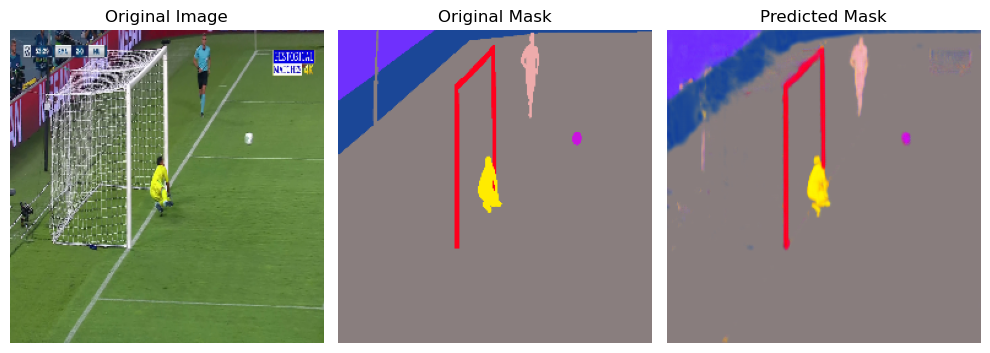

Epoch 76/100
25/25 [==============================] - 7s 265ms/step - loss: 0.4946 - accuracy: 0.9870 - val_loss: 0.5827 - val_accuracy: 0.9876


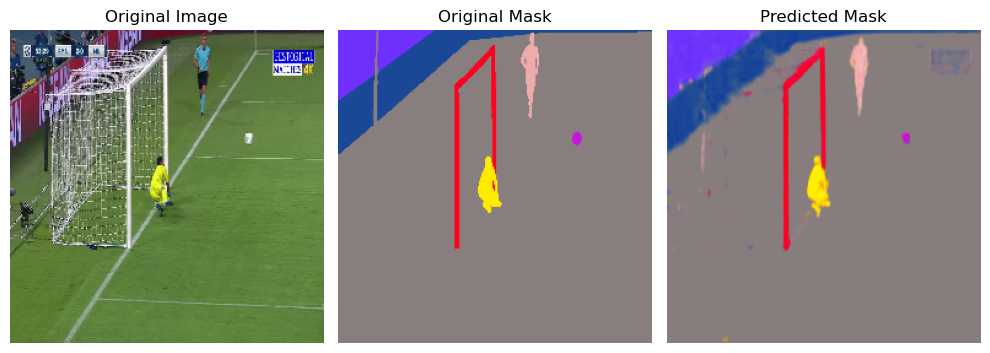

Epoch 77/100
25/25 [==============================] - 7s 266ms/step - loss: 0.5279 - accuracy: 0.9849 - val_loss: 0.5829 - val_accuracy: 0.9872


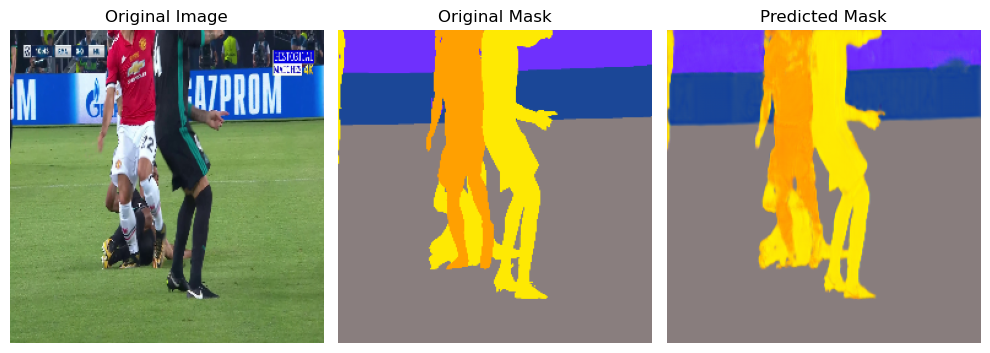

Epoch 78/100
25/25 [==============================] - 7s 268ms/step - loss: 0.4886 - accuracy: 0.9864 - val_loss: 0.5832 - val_accuracy: 0.9865


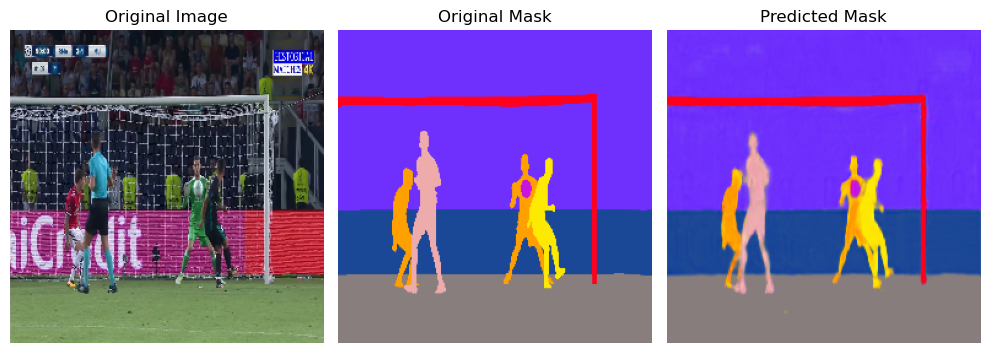

Epoch 79/100
25/25 [==============================] - 7s 269ms/step - loss: 0.4877 - accuracy: 0.9865 - val_loss: 0.5824 - val_accuracy: 0.9879


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 0.9s


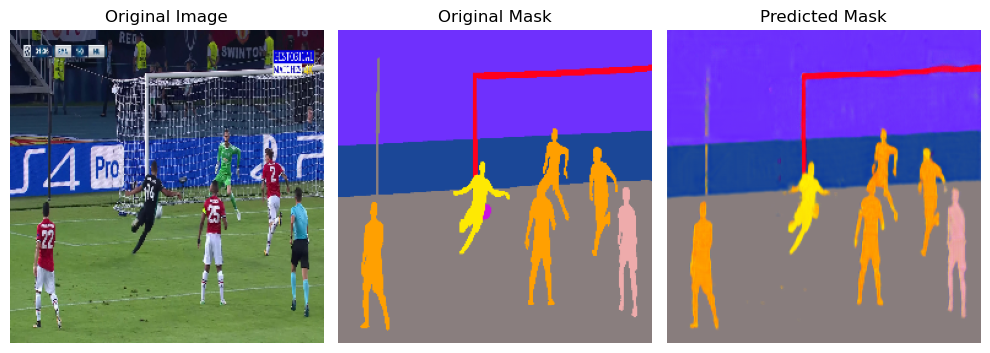

Epoch 80/100
25/25 [==============================] - 7s 266ms/step - loss: 0.5038 - accuracy: 0.9876 - val_loss: 0.5824 - val_accuracy: 0.9881


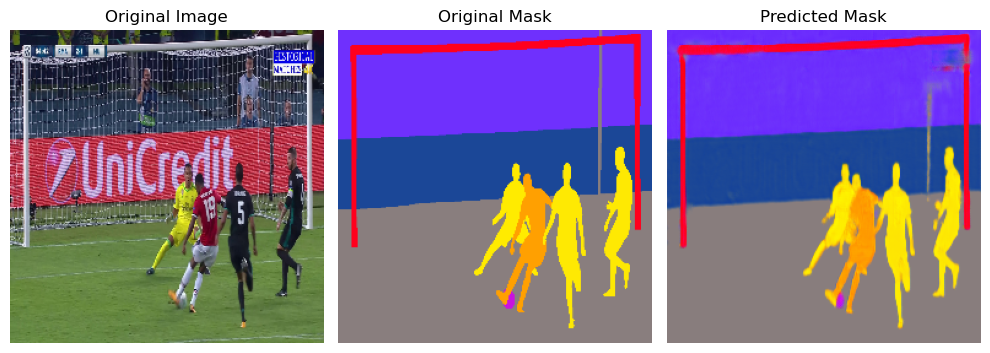

Epoch 81/100
25/25 [==============================] - 7s 267ms/step - loss: 0.4934 - accuracy: 0.9874 - val_loss: 0.5822 - val_accuracy: 0.9877


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 0.9s


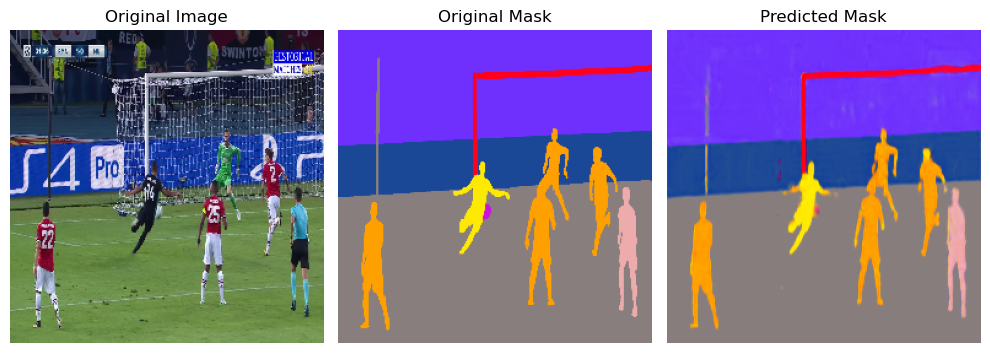

Epoch 82/100
25/25 [==============================] - 7s 265ms/step - loss: 0.5100 - accuracy: 0.9873 - val_loss: 0.5823 - val_accuracy: 0.9887


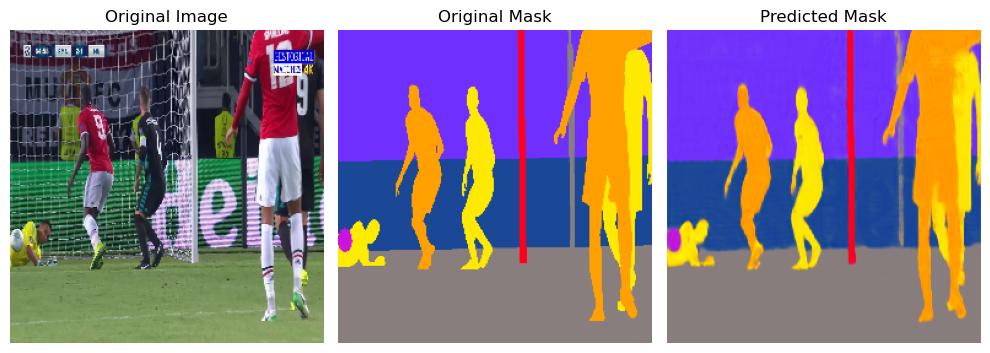

Epoch 83/100
25/25 [==============================] - 7s 266ms/step - loss: 0.5035 - accuracy: 0.9879 - val_loss: 0.5823 - val_accuracy: 0.9884


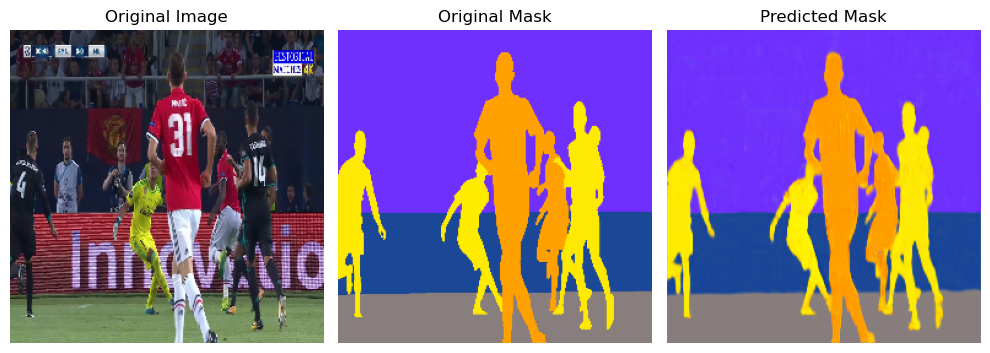

Epoch 84/100
25/25 [==============================] - 7s 268ms/step - loss: 0.5063 - accuracy: 0.9876 - val_loss: 0.5825 - val_accuracy: 0.9875


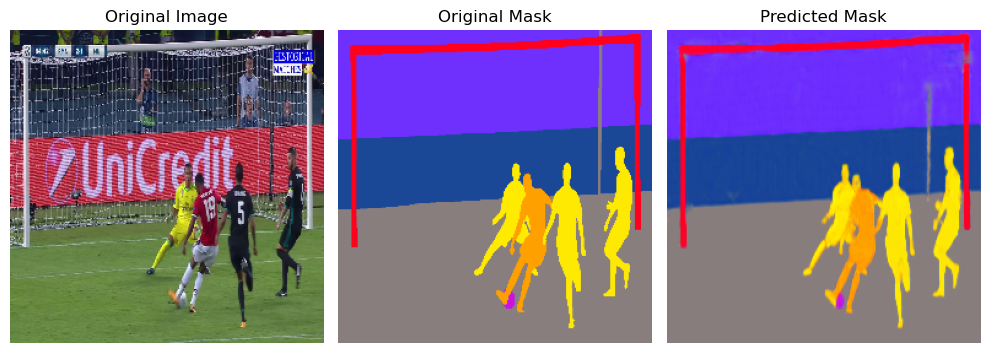

Epoch 85/100
25/25 [==============================] - 7s 280ms/step - loss: 0.4979 - accuracy: 0.9868 - val_loss: 0.5825 - val_accuracy: 0.9885


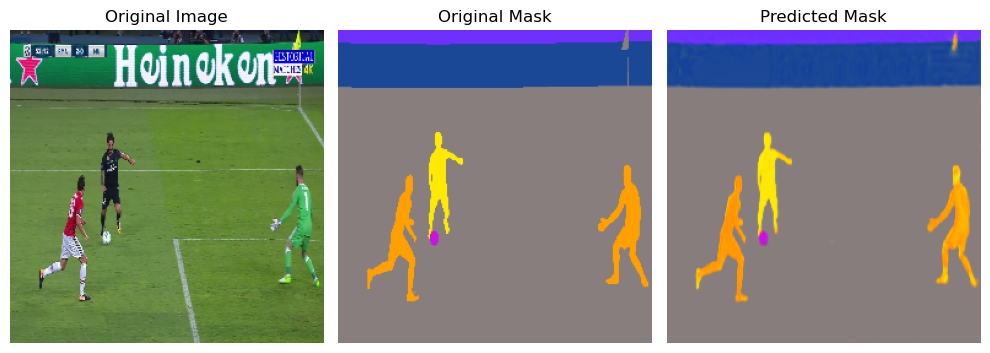

Epoch 86/100
25/25 [==============================] - 7s 284ms/step - loss: 0.4944 - accuracy: 0.9872 - val_loss: 0.5825 - val_accuracy: 0.9879


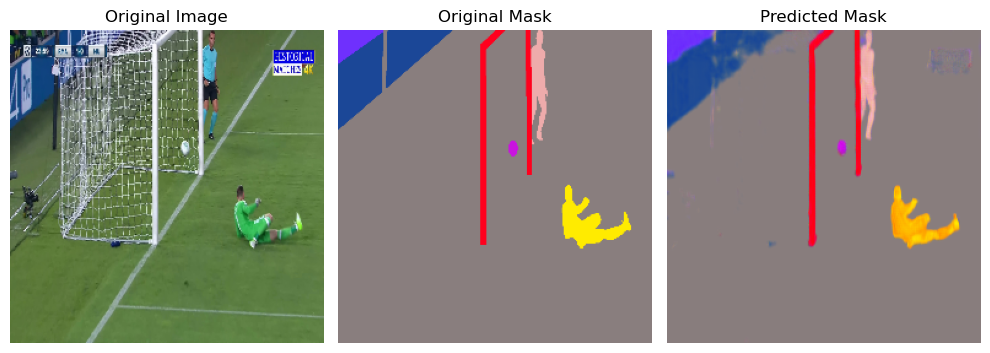

Epoch 87/100
25/25 [==============================] - 7s 278ms/step - loss: 0.5017 - accuracy: 0.9860 - val_loss: 0.5829 - val_accuracy: 0.9869


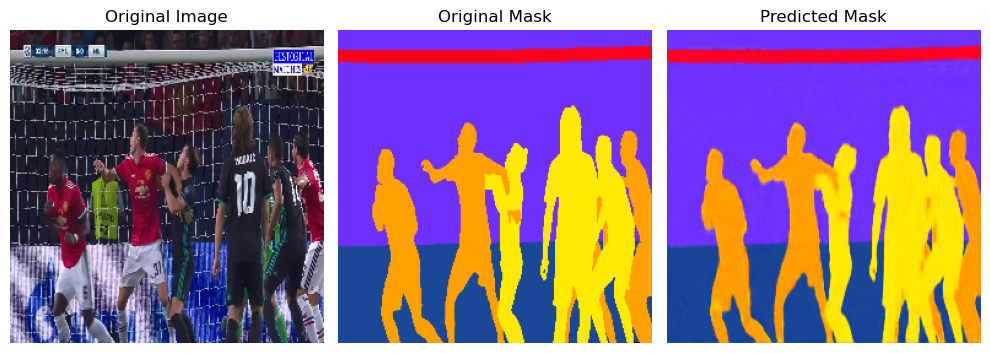

Epoch 88/100
25/25 [==============================] - 7s 277ms/step - loss: 0.4798 - accuracy: 0.9872 - val_loss: 0.5826 - val_accuracy: 0.9878


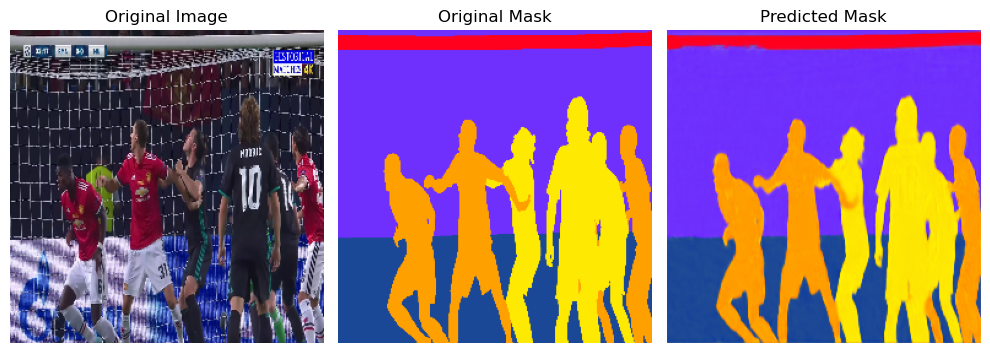

Epoch 89/100
25/25 [==============================] - 7s 283ms/step - loss: 0.4753 - accuracy: 0.9870 - val_loss: 0.5832 - val_accuracy: 0.9869


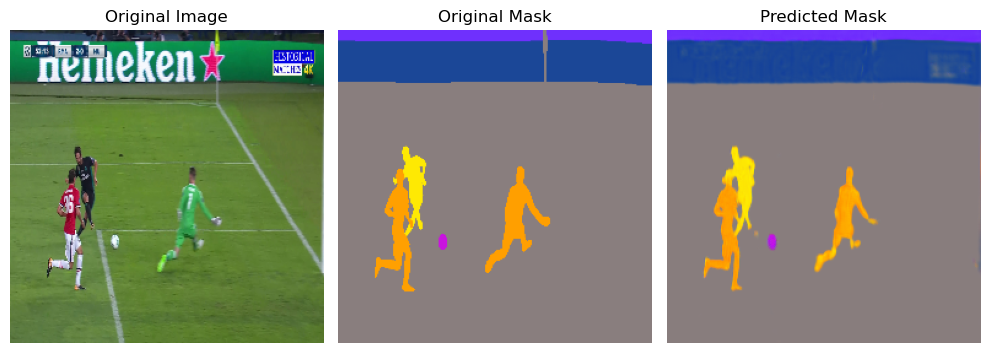

Epoch 90/100
25/25 [==============================] - 7s 282ms/step - loss: 0.5078 - accuracy: 0.9886 - val_loss: 0.5821 - val_accuracy: 0.9883


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 0.9s


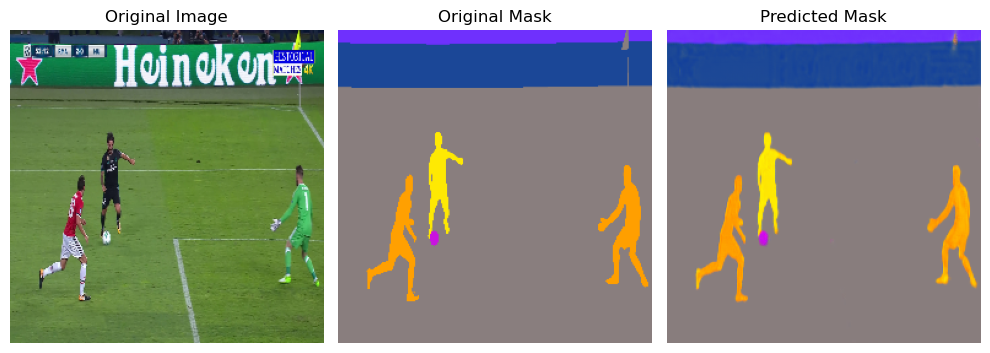

Epoch 91/100
25/25 [==============================] - 7s 282ms/step - loss: 0.4725 - accuracy: 0.9879 - val_loss: 0.5821 - val_accuracy: 0.9889


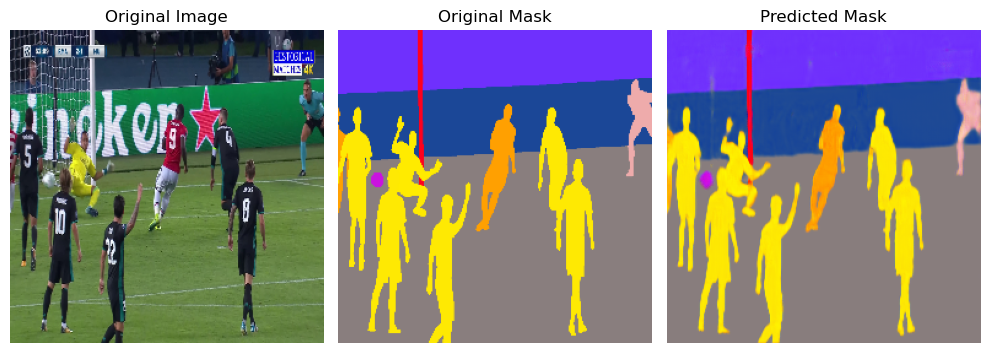

Epoch 92/100
25/25 [==============================] - 7s 273ms/step - loss: 0.4956 - accuracy: 0.9884 - val_loss: 0.5820 - val_accuracy: 0.9879


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets


INFO:tensorflow:Assets written to: d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best\assets
wandb: Adding directory to artifact (d:\code_study\ML_CODE\kaggle\Segmentation\Football_Semantic_Segmentation\Football Player Segmentation UNet\wandb\run-20250311_145454-wpx3yu8y\files\model-best)... Done. 1.1s


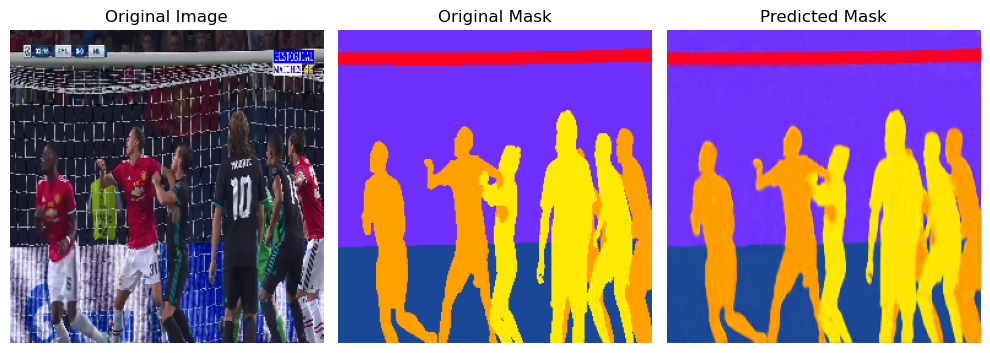

Epoch 93/100


25/25 [==============================] - 0s 12ms/step - loss: 0.4953 - accuracy: 0.9882 - val_loss: 0.5820 - val_accuracy: 0.9879


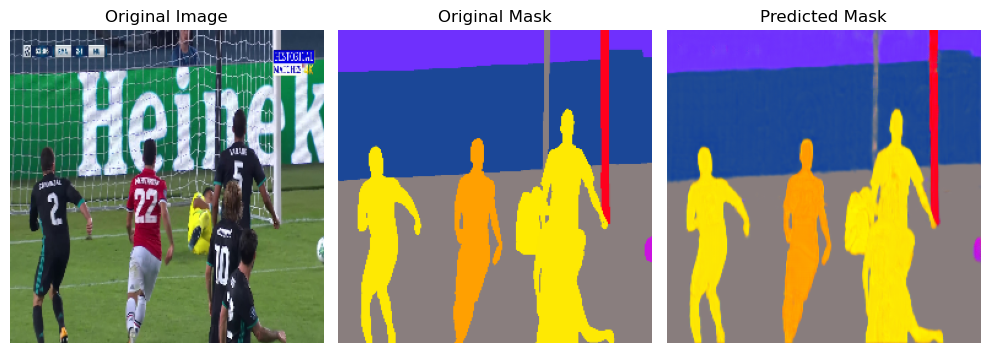

In [18]:
SPE = len(images)//hyperparameter_defaults["batch_size"]
model.fit(
    images, label_maps,
    validation_split=0.1,
    epochs=hyperparameter_defaults["epochs"],
    batch_size=hyperparameter_defaults["batch_size"],
    steps_per_epoch=SPE,
    callbacks=callbacks
)